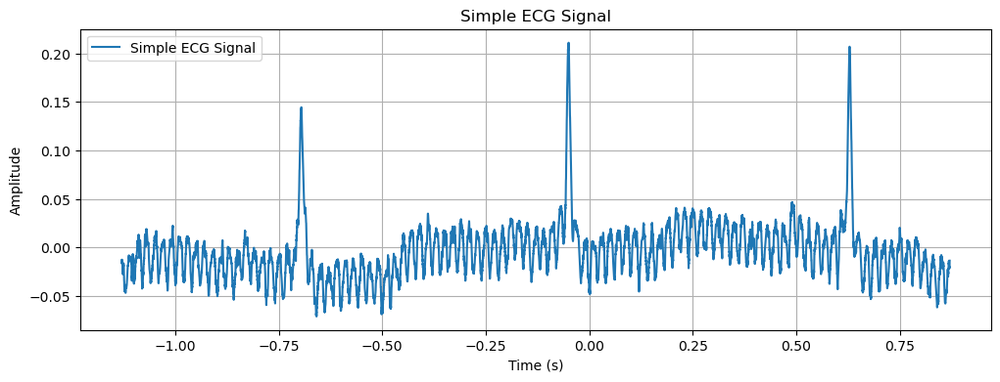

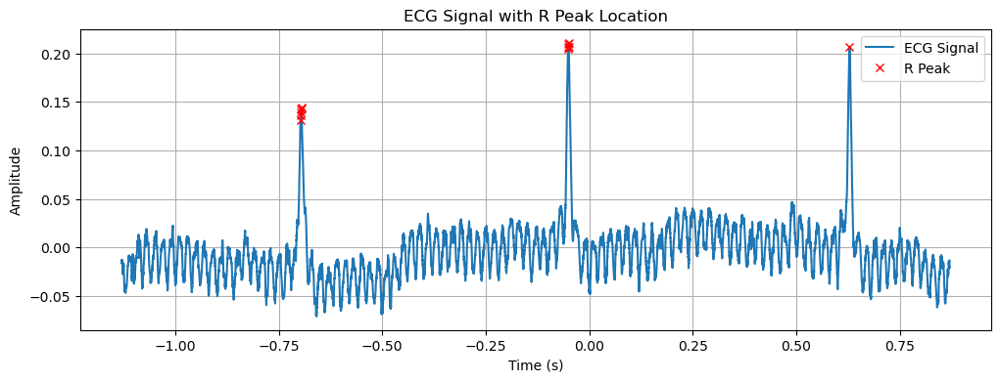

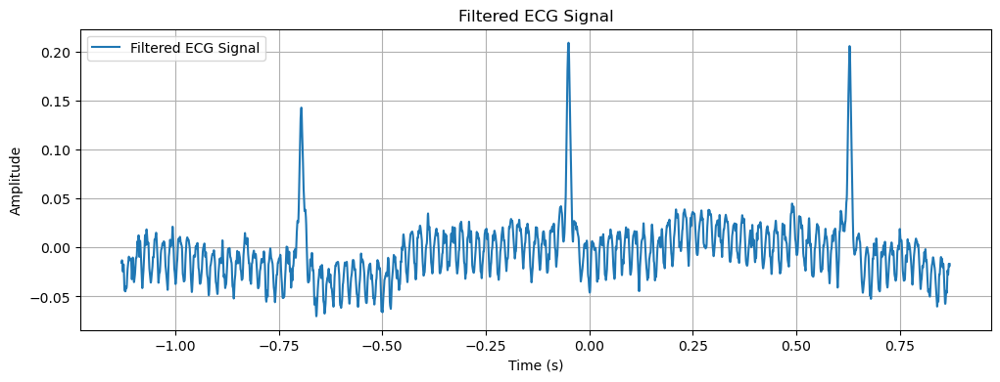

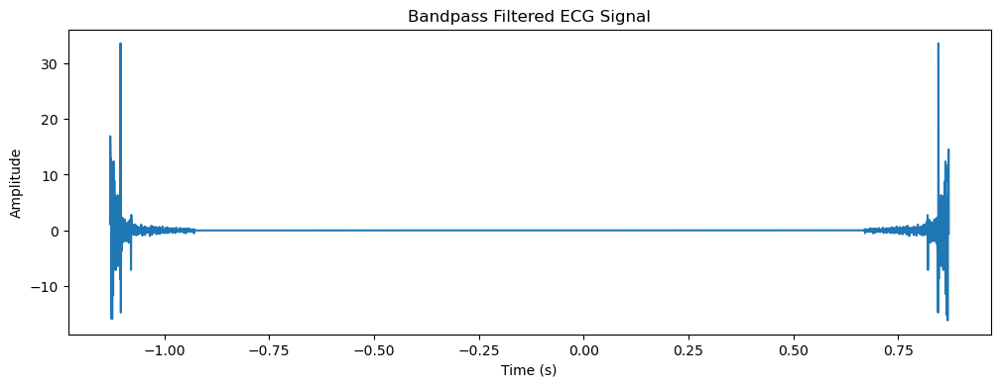

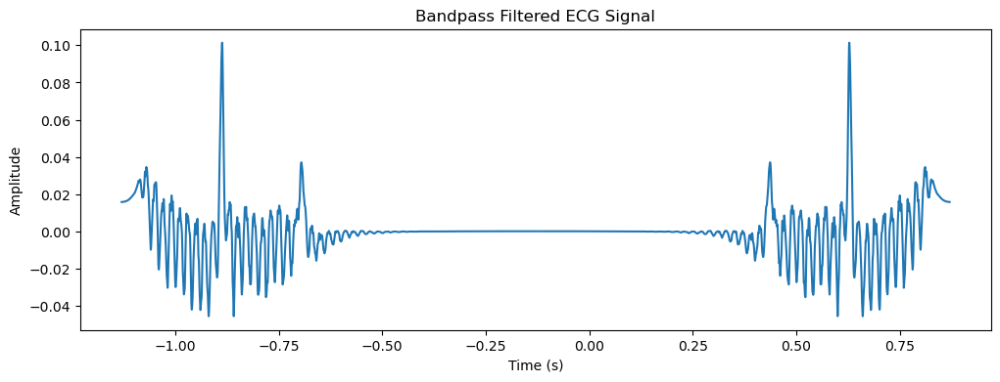

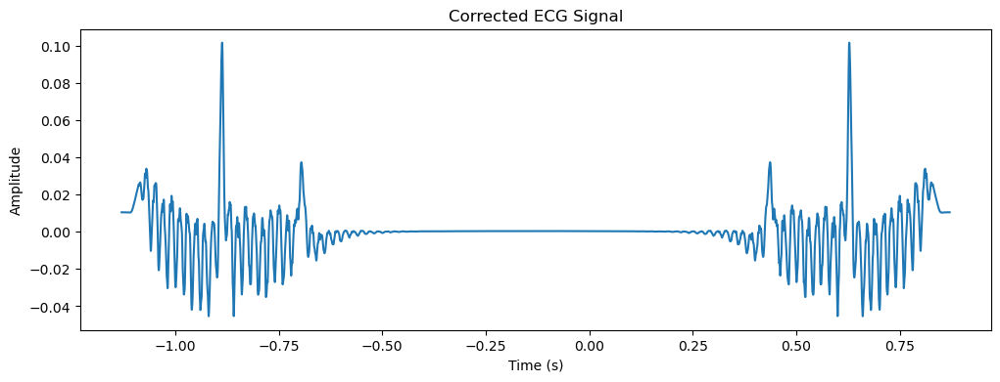

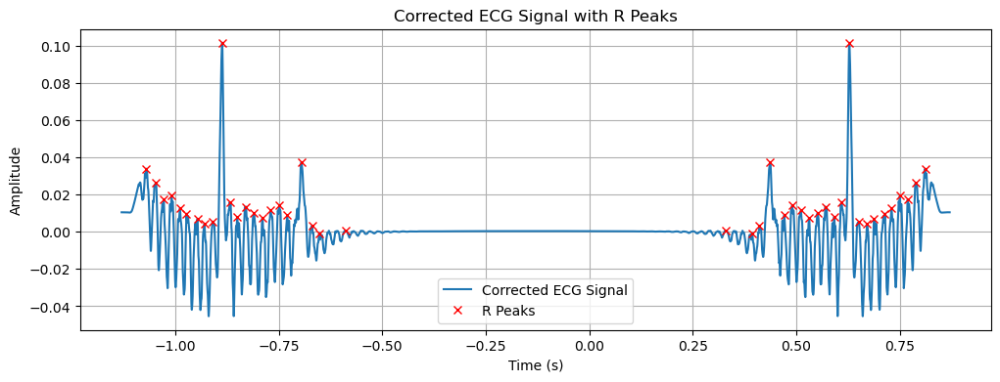

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import fft, ifft
import pandas as pd

# Load the ECG signal (replace 'path_to_ecg_file.csv' with the actual file path)
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")

# Extract amplitude and time
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Define a filter in the frequency domain to preserve the R peak
def frequency_domain_filter(signal, peak_indices, cutoff_freq):
    signal = np.asarray(signal)  # Convert to numpy array
    fft_signal = fft(signal)
    freqs = np.fft.fftfreq(len(signal))
    for idx in peak_indices:
        fft_signal[(freqs < -cutoff_freq)] = 0
        fft_signal[(freqs > cutoff_freq)] = 0
    return np.real(ifft(fft_signal))

# Apply the filter to the ECG signal
cutoff_frequency = 0.1  # Adjust as needed
filtered_ecg = frequency_domain_filter(ecg, peaks, cutoff_frequency)

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Bandpass filtering
Fs = 360
low_cut = 10
high_cut = 80
Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
b, a = butter(N=3, Wn=Bw, btype='band')
fft_filtered = filtfilt(b, a, fft(filtered_ecg)).real

plt.figure(figsize=(12, 4))
plt.plot(time, fft_filtered)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Bandpass Filtered ECG Signal")
plt.show()

# Inverse Fourier Transform
ecg_filtered = ifft(fft_filtered).real
plt.figure(figsize=(12, 4))
plt.plot(time, ecg_filtered)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Bandpass Filtered ECG Signal")
plt.show()

# Base correction
def base_correction(ecg_signal, window_size):
    x = fft(ecg_signal)
    Fc = 5
    F_normal = Fc / (Fs / 2)
    b, a = butter(N=5, Wn=F_normal, btype='high')
    filtered = filtfilt(b, a, x).real
    return ifft(filtered).real

ecg_corrected = base_correction(ecg_signal=ecg_filtered, window_size=5)

plt.figure(figsize=(12, 4))
plt.plot(time, ecg_corrected)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Corrected ECG Signal")
plt.show()

# Find R Peaks
THETA = 0.1
peaks_corrected, _ = find_peaks(x=ecg_corrected, prominence=THETA * np.max(ecg_corrected))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg_corrected, label='Corrected ECG Signal')
plt.plot(time[peaks_corrected], ecg_corrected[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Corrected ECG Signal with R Peaks")
plt.legend()
plt.grid(True)
plt.show()

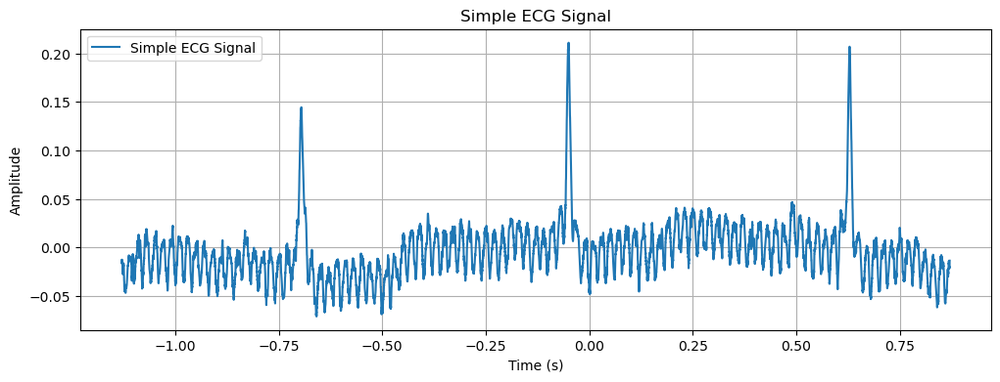

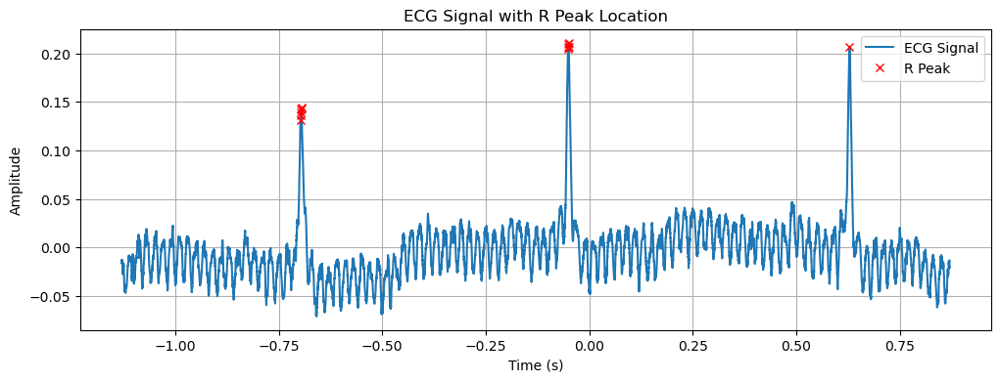

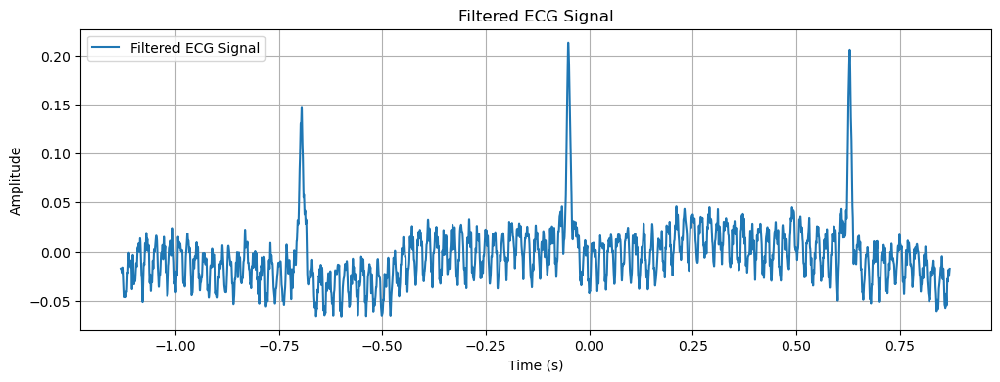

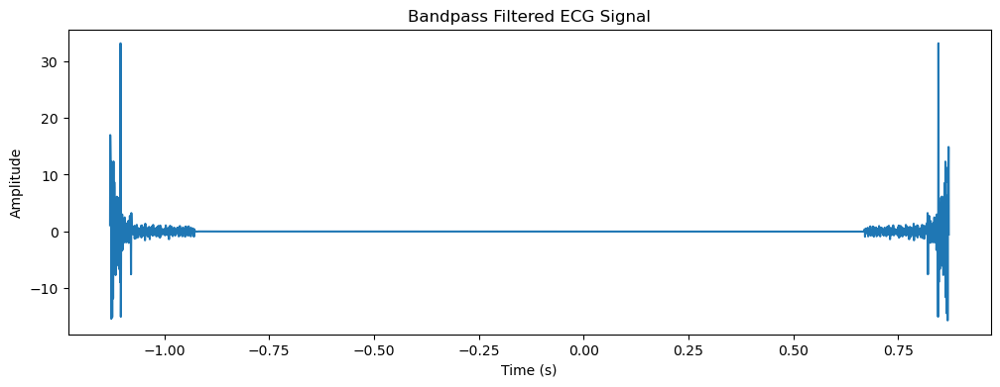

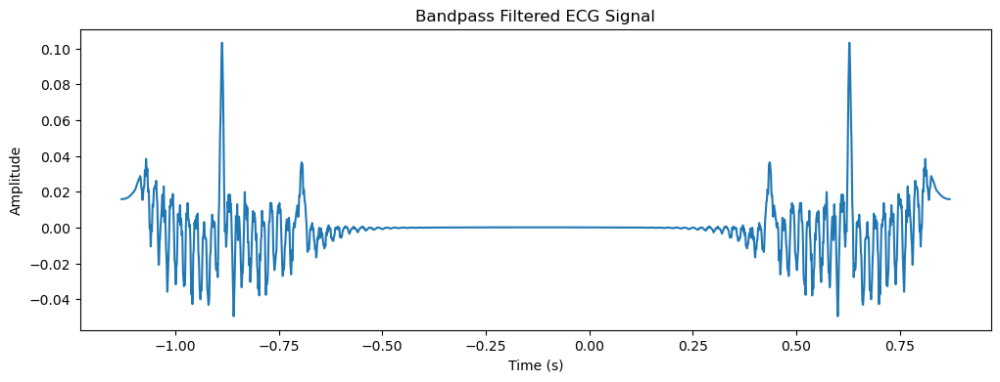

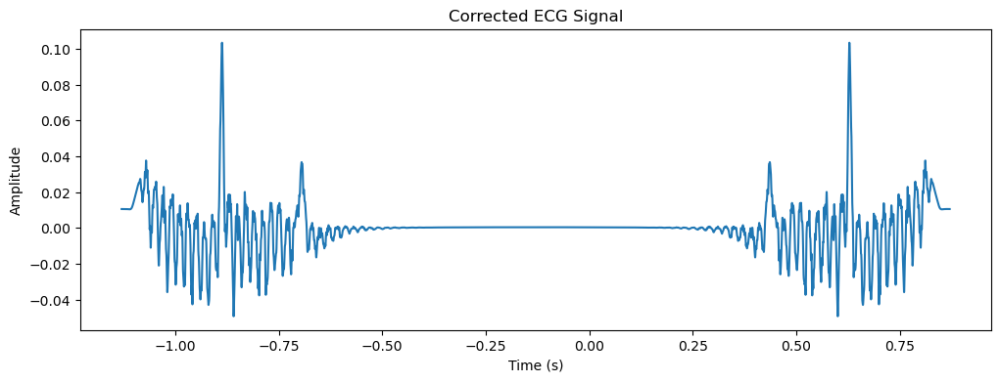

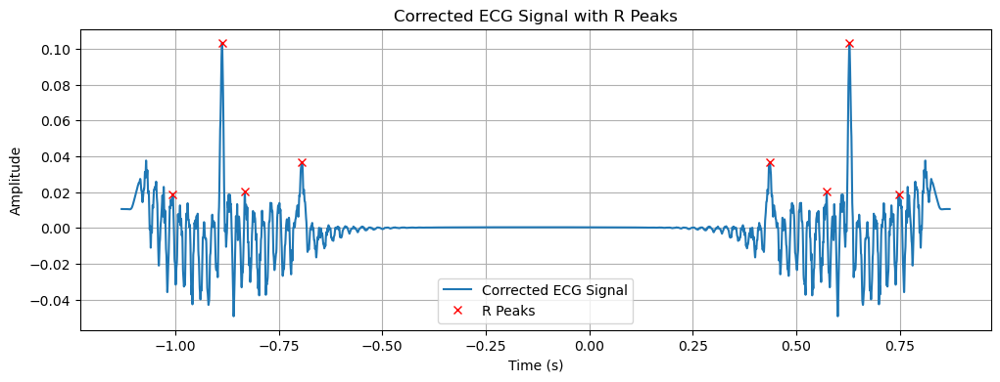

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import fft, ifft
import pandas as pd

# Load the ECG signal (replace 'path_to_ecg_file.csv' with the actual file path)
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")

# Extract amplitude and time
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']


# Plot simple ECG signal with noise
plt.figure(figsize=(12, 4))
plt.plot(time, noisy_ecg, label='Noisy ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noisy ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak in the noisy ECG signal
peaks, _ = find_peaks(noisy_ecg, height=0.6 * np.max(noisy_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, noisy_ecg, label='Noisy ECG Signal')
plt.plot(time[peaks], noisy_ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noisy ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()





# Add noise to the ECG signal
noise_level = 0.1  # Adjust as needed
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))

# Define a filter in the frequency domain to preserve the R peak
def frequency_domain_filter(signal, peak_indices, cutoff_freq):
    signal = np.asarray(signal)  # Convert to numpy array
    fft_signal = fft(signal)
    freqs = np.fft.fftfreq(len(signal))
    for idx in peak_indices:
        fft_signal[(freqs < -cutoff_freq)] = 0
        fft_signal[(freqs > cutoff_freq)] = 0
    return np.real(ifft(fft_signal))

# Apply the filter to the noisy ECG signal
cutoff_frequency = 0.1  # Adjust as needed
filtered_ecg = frequency_domain_filter(noisy_ecg, peaks, cutoff_frequency)

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Bandpass filtering
Fs = 360
low_cut = 10
high_cut = 80
Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
b, a = butter(N=3, Wn=Bw, btype='band')
fft_filtered = filtfilt(b, a, fft(filtered_ecg)).real

plt.figure(figsize=(12, 4))
plt.plot(time, fft_filtered)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Bandpass Filtered ECG Signal")
plt.show()

# Inverse Fourier Transform
ecg_filtered = ifft(fft_filtered).real
plt.figure(figsize=(12, 4))
plt.plot(time, ecg_filtered)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Bandpass Filtered ECG Signal")
plt.show()

# Base correction
def base_correction(ecg_signal, window_size):
    x = fft(ecg_signal)
    Fc = 5
    F_normal = Fc / (Fs / 2)
    b, a = butter(N=5, Wn=F_normal, btype='high')
    filtered = filtfilt(b, a, x).real
    return ifft(filtered).real

ecg_corrected = base_correction(ecg_signal=ecg_filtered, window_size=5)

plt.figure(figsize=(12, 4))
plt.plot(time, ecg_corrected)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Corrected ECG Signal")
plt.show()

# Find R Peaks
THETA = 0.1
peaks_corrected, _ = find_peaks(x=ecg_corrected, prominence=THETA * np.max(ecg_corrected))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg_corrected, label='Corrected ECG Signal')
plt.plot(time[peaks_corrected], ecg_corrected[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Corrected ECG Signal with R Peaks")
plt.legend()
plt.grid(True)
plt.show()

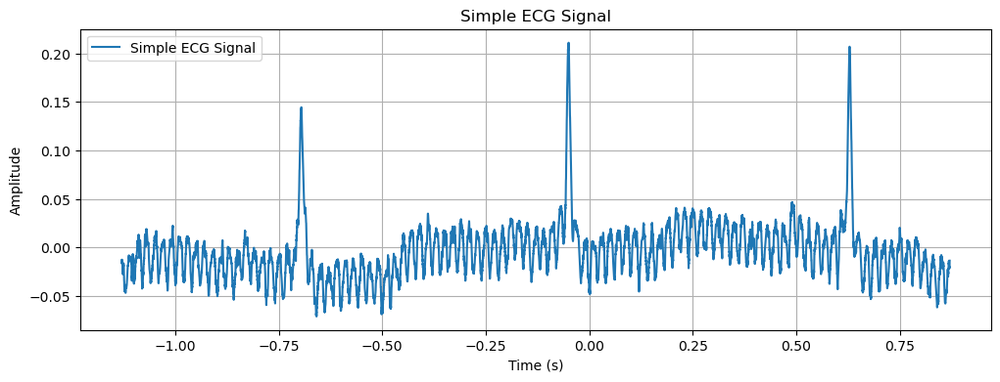

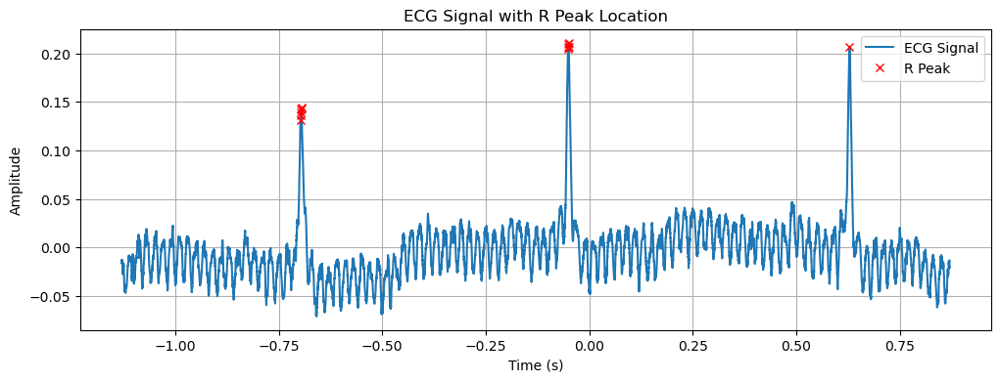

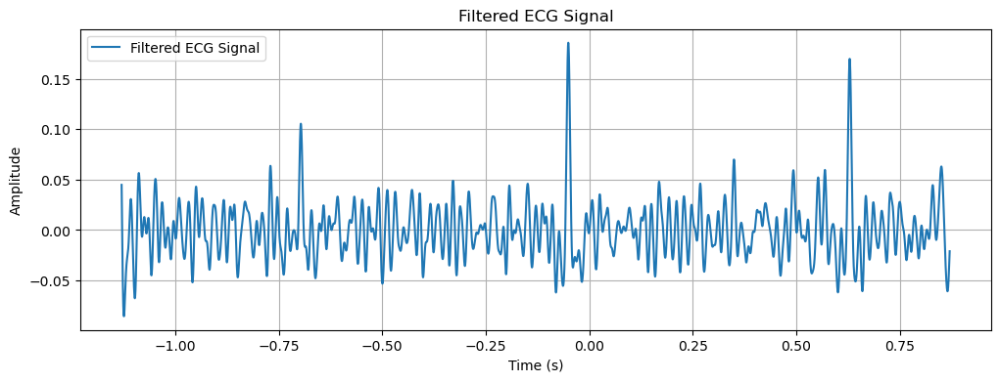

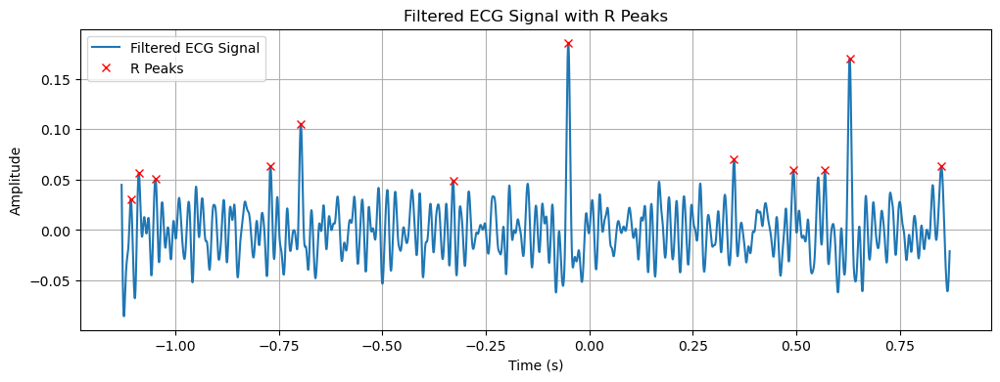

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import ifft
import pandas as pd

# Load the ECG signal
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Add noise to the ECG signal
noise_level = 0.1
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))

# Butterworth filter
def butterworth_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the Butterworth filter to the noisy ECG signal
filtered_ecg = butterworth_filter(noisy_ecg, low_cut=10, high_cut=80, Fs=1/(time[1]-time[0]))

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Find R Peaks
THETA = 0.5
peaks_corrected, _ = find_peaks(x=filtered_ecg, prominence=THETA * np.max(filtered_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.plot(time[peaks_corrected], filtered_ecg[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal with R Peaks')
plt.legend()
plt.grid(True)
plt.show()


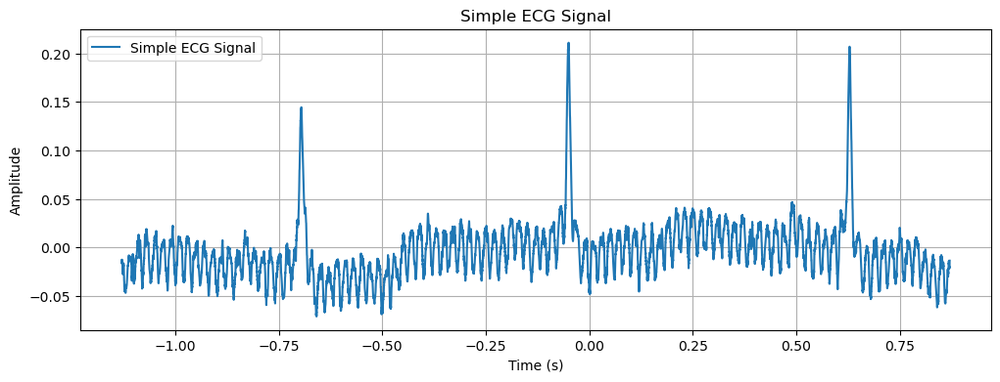

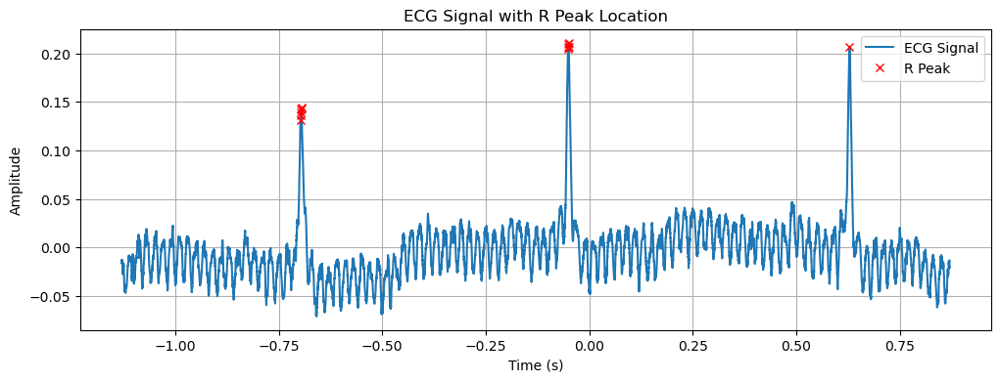

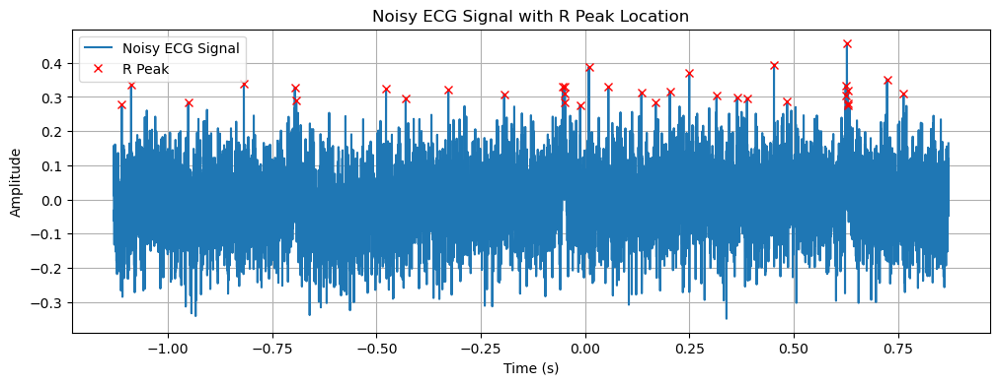

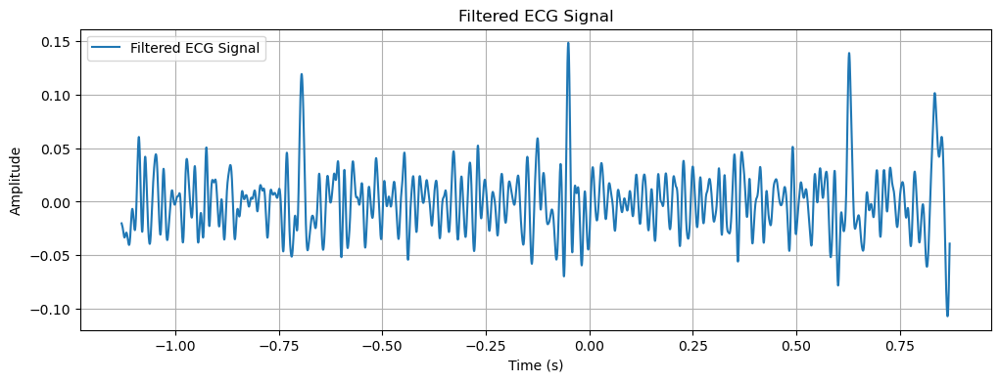

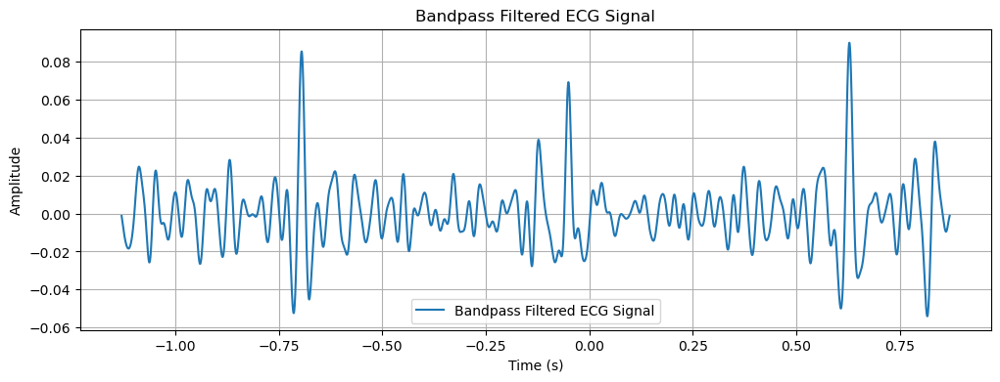

/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


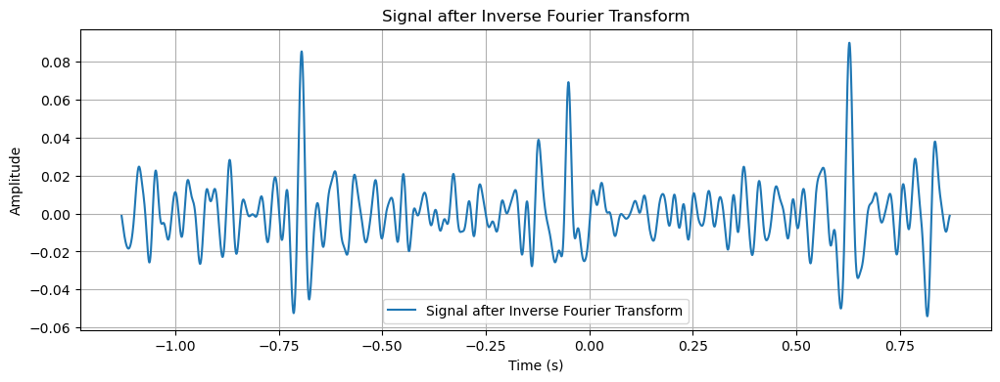

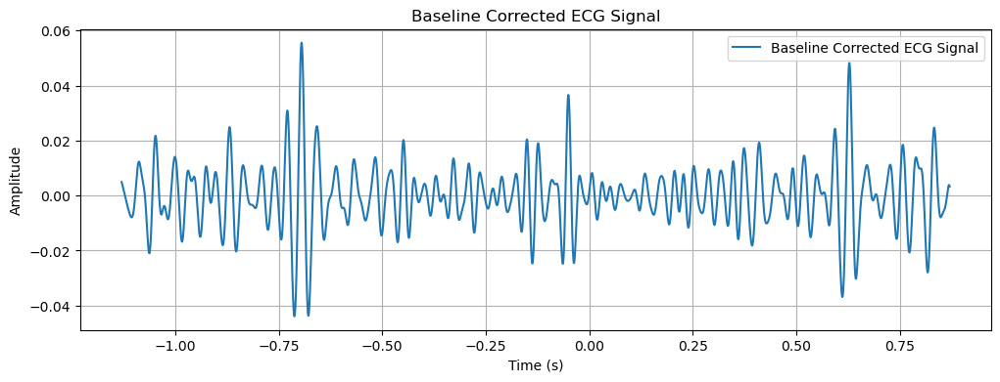

/home/nalin/anaconda3/lib/python3.9/site-packages/scipy/signal/_peak_finding.py:261: ComplexWarning: Casting complex values to real discards the imaginary part
  value = np.asarray(value, order='C', dtype=np.float64)
/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


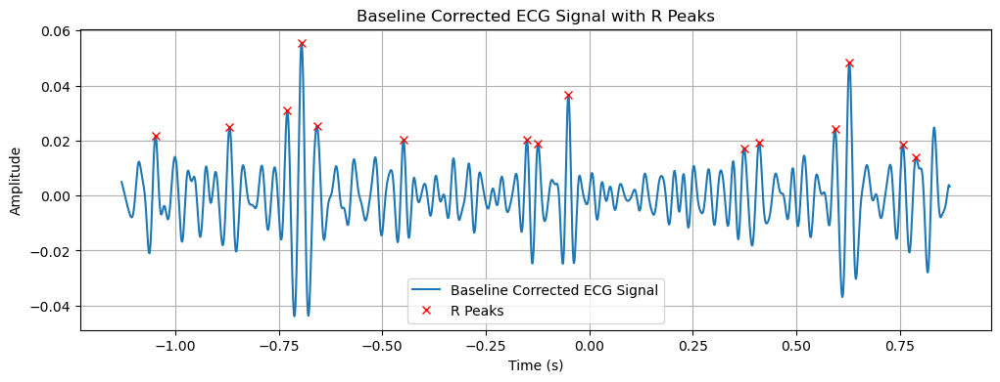

In [28]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import ifft
import pandas as pd

# Load the ECG signal
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Add noise to the ECG signal
noise_level = 0.1
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))


# Compute and show the location of the R peak in the noisy ECG signal
peaks, _ = find_peaks(noisy_ecg, height=0.6 * np.max(noisy_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, noisy_ecg, label='Noisy ECG Signal')
plt.plot(time[peaks], noisy_ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noisy ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()


# Butterworth filter
def butterworth_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the Butterworth filter to the noisy ECG signal
filtered_ecg = butterworth_filter(noisy_ecg, low_cut=10, high_cut=80, Fs=1/(time[1]-time[0]))

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Bandpass filtering
def bandpass_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the bandpass filter to the filtered ECG signal
bandpass_filtered_ecg = bandpass_filter(filtered_ecg, low_cut=10, high_cut=40, Fs=1/(time[1]-time[0]))

# Plot the bandpass filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, bandpass_filtered_ecg, label='Bandpass Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Bandpass Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Inverse Fourier Transform
fft_filtered_ecg = fft(bandpass_filtered_ecg)
inverse_fft_filtered_ecg = ifft(fft_filtered_ecg)

# Plot the signal after inverse Fourier Transform
plt.figure(figsize=(12, 4))
plt.plot(time, inverse_fft_filtered_ecg, label='Signal after Inverse Fourier Transform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Signal after Inverse Fourier Transform')
plt.legend()
plt.grid(True)
plt.show()

# Base-line correction
def baseline_correction(signal, window_size):
    b, a = butter(N=5, Wn=0.01, btype='high')
    return filtfilt(b, a, signal)

baseline_corrected_ecg = baseline_correction(inverse_fft_filtered_ecg, window_size=5)

# Plot the baseline corrected ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Find R Peaks
THETA = 0.6
peaks_corrected, _ = find_peaks(x=baseline_corrected_ecg, prominence=THETA * np.max(baseline_corrected_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.plot(time[peaks_corrected], baseline_corrected_ecg[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal with R Peaks')
plt.legend()
plt.grid(True)
plt.show()


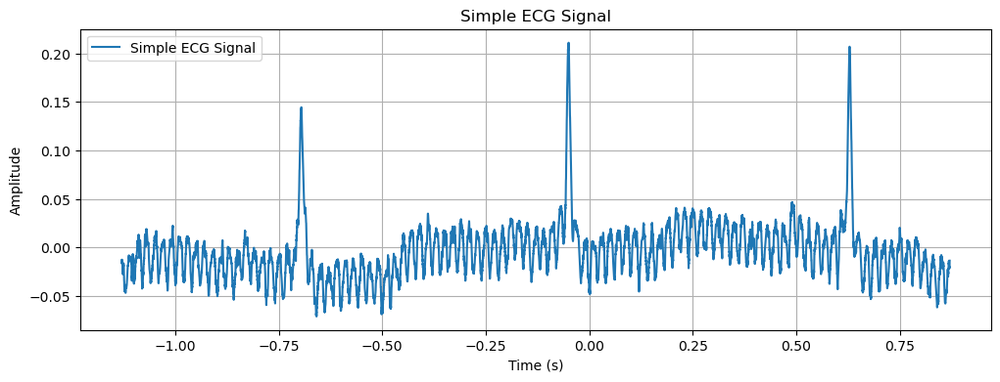

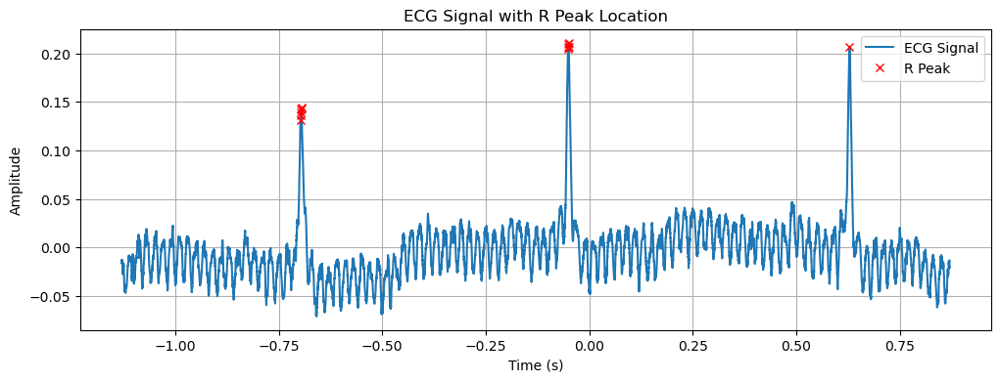

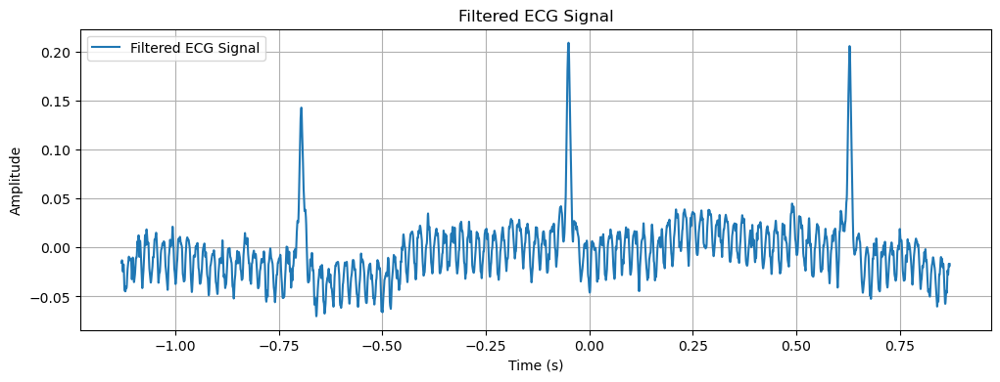

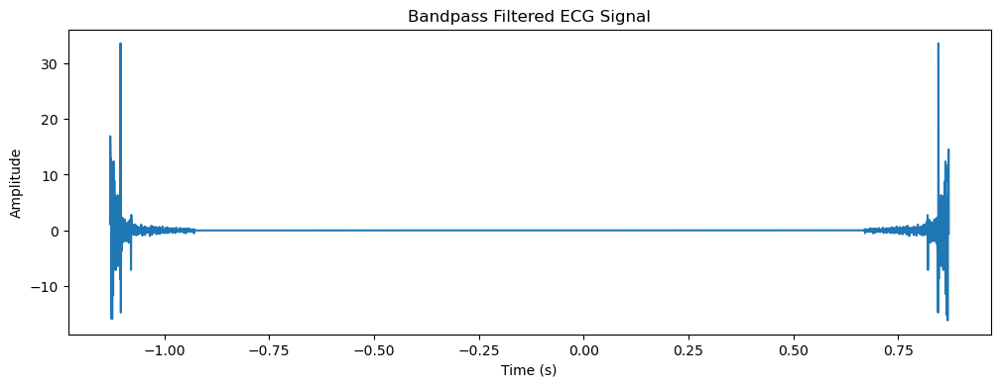

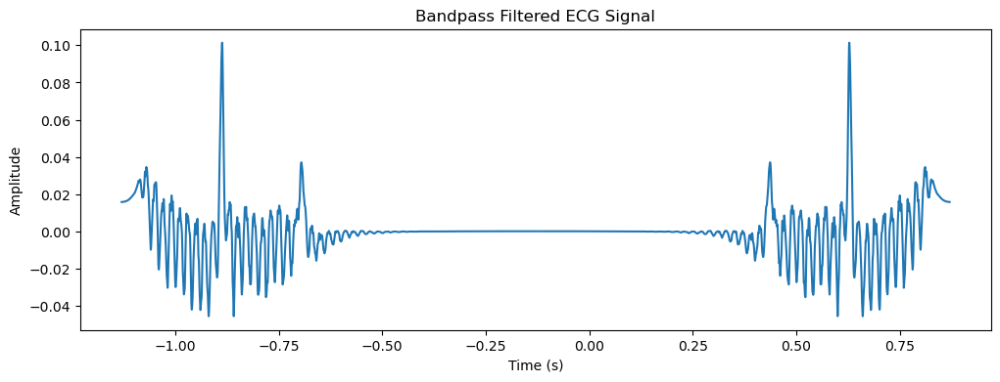

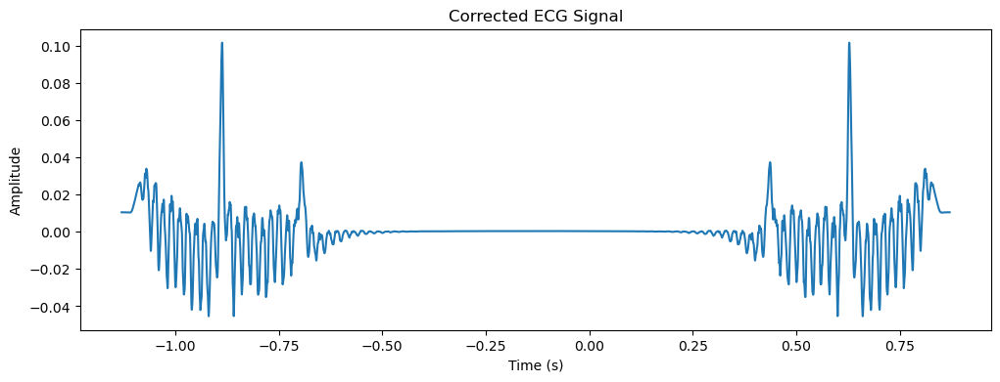

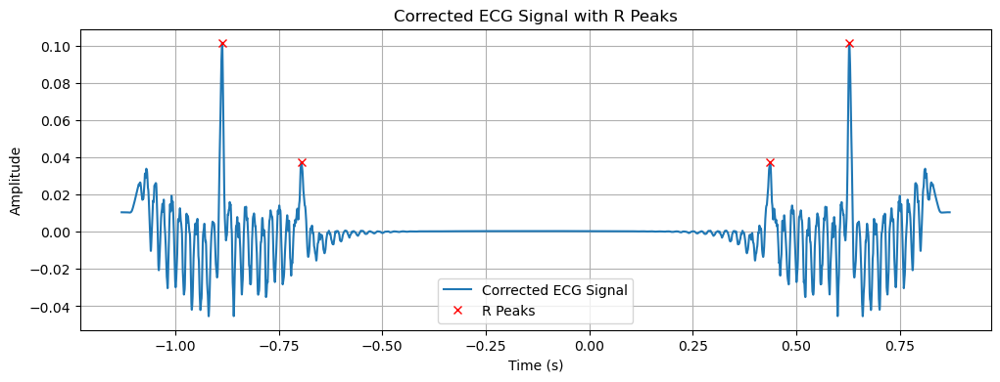

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import fft, ifft
import pandas as pd

# Load the ECG signal (replace 'path_to_ecg_file.csv' with the actual file path)
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")

# Extract amplitude and time
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Define a filter in the frequency domain to preserve the R peak
def frequency_domain_filter(signal, peak_indices, cutoff_freq):
    signal = np.asarray(signal)  # Convert to numpy array
    fft_signal = fft(signal)
    freqs = np.fft.fftfreq(len(signal))
    for idx in peak_indices:
        fft_signal[(freqs < -cutoff_freq)] = 0
        fft_signal[(freqs > cutoff_freq)] = 0
    return np.real(ifft(fft_signal))

# Apply the filter to the ECG signal
cutoff_frequency = 0.1  # Adjust as needed
filtered_ecg = frequency_domain_filter(ecg, peaks, cutoff_frequency)

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Bandpass filtering
Fs = 360
low_cut = 10
high_cut = 80
Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
b, a = butter(N=3, Wn=Bw, btype='band')
fft_filtered = filtfilt(b, a, fft(filtered_ecg)).real

plt.figure(figsize=(12, 4))
plt.plot(time, fft_filtered)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Bandpass Filtered ECG Signal")
plt.show()

# Inverse Fourier Transform
ecg_filtered = ifft(fft_filtered).real
plt.figure(figsize=(12, 4))
plt.plot(time, ecg_filtered)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Bandpass Filtered ECG Signal")
plt.show()

# Base correction
def base_correction(ecg_signal, window_size):
    x = fft(ecg_signal)
    Fc = 5
    F_normal = Fc / (Fs / 2)
    b, a = butter(N=5, Wn=F_normal, btype='high')
    filtered = filtfilt(b, a, x).real
    return ifft(filtered).real

ecg_corrected = base_correction(ecg_signal=ecg_filtered, window_size=5)

plt.figure(figsize=(12, 4))
plt.plot(time, ecg_corrected)
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Corrected ECG Signal")
plt.show()

# Find R Peaks
THETA = 0.5
peaks_corrected, _ = find_peaks(x=ecg_corrected, prominence=THETA * np.max(ecg_corrected))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg_corrected, label='Corrected ECG Signal')
plt.plot(time[peaks_corrected], ecg_corrected[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel("Time (s)")
plt.ylabel("Amplitude")
plt.title("Corrected ECG Signal with R Peaks")
plt.legend()
plt.grid(True)
plt.show()

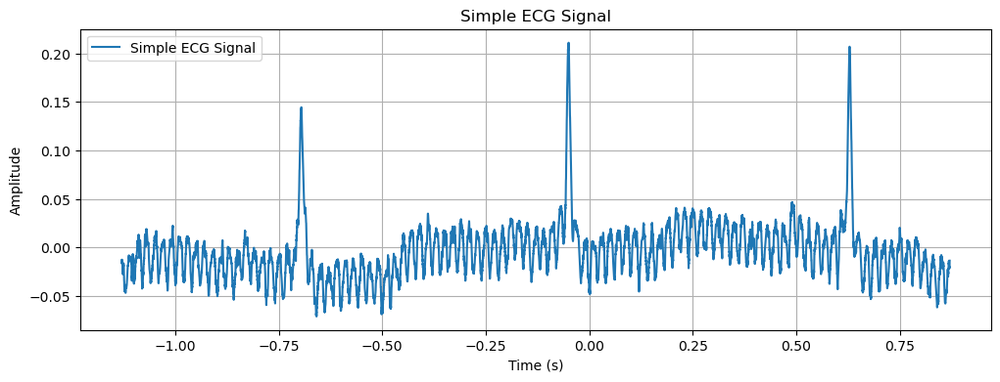

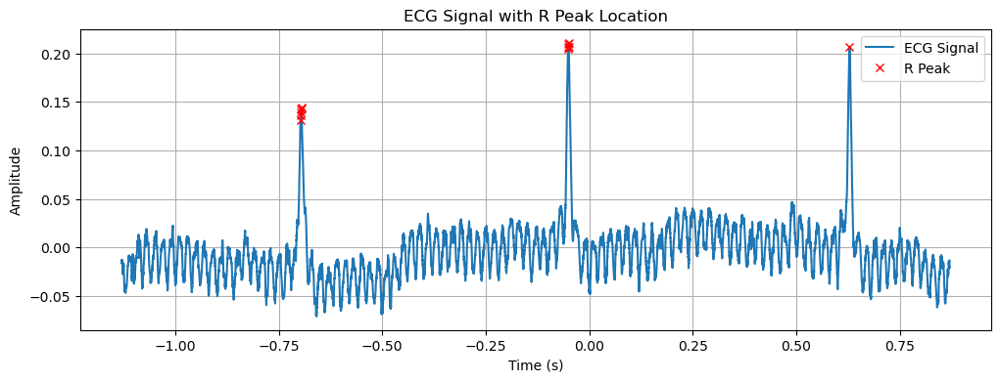

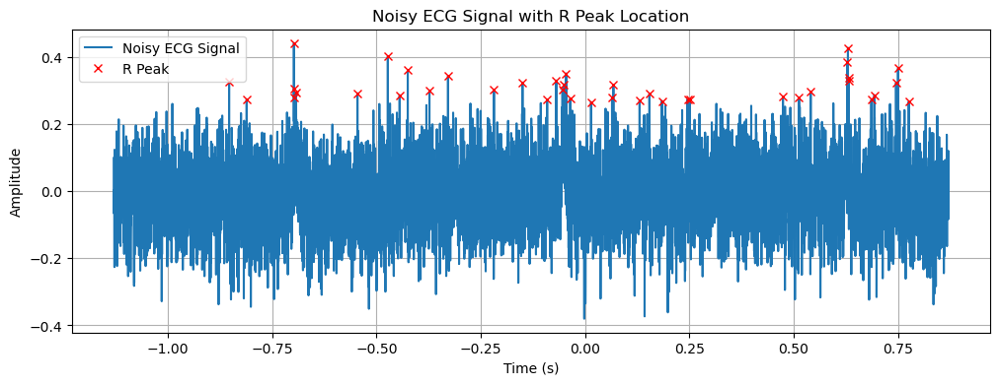

/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


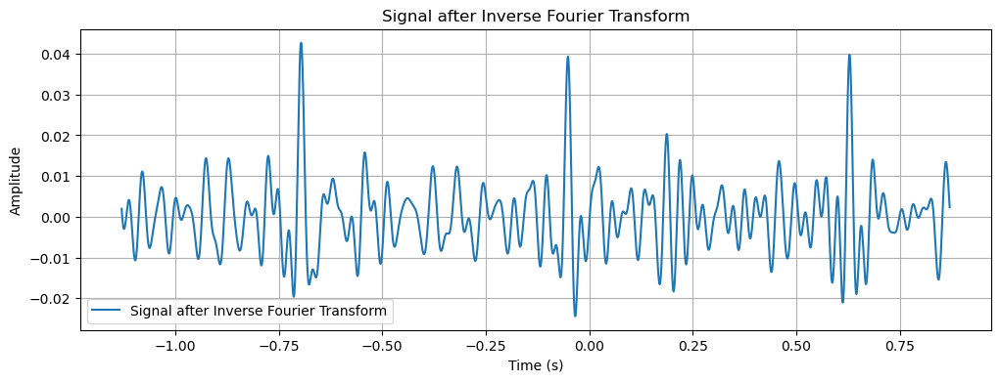

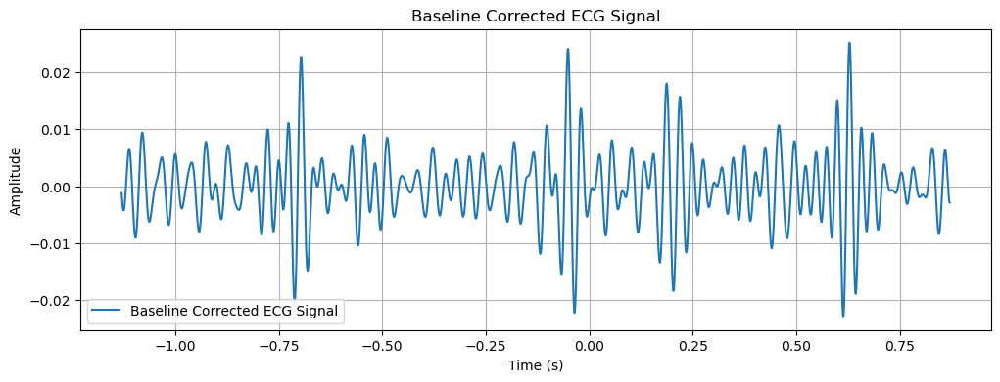

/home/nalin/anaconda3/lib/python3.9/site-packages/scipy/signal/_peak_finding.py:261: ComplexWarning: Casting complex values to real discards the imaginary part
  value = np.asarray(value, order='C', dtype=np.float64)
/home/nalin/anaconda3/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1298: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


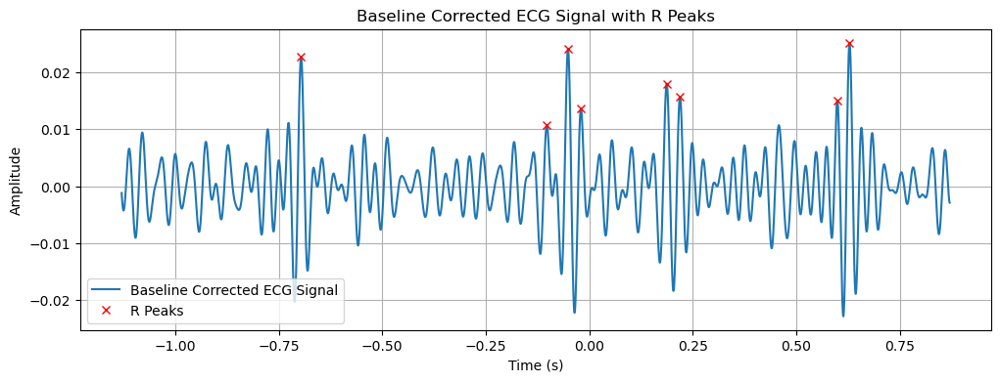

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import ifft
import pandas as pd

# Load the ECG signal
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Add noise to the ECG signal
noise_level = 0.1
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))

# Compute and show the location of the R peak in the noisy ECG signal
peaks, _ = find_peaks(noisy_ecg, height=0.6 * np.max(noisy_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, noisy_ecg, label='Noisy ECG Signal')
plt.plot(time[peaks], noisy_ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noisy ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Butterworth filter
def butterworth_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the Butterworth filter to the noisy ECG signal
filtered_ecg = butterworth_filter(noisy_ecg, low_cut=10, high_cut=80, Fs=1/(time[1]-time[0]))

# Bandpass filtering in frequency domain
def bandpass_filter_freq(signal, low_cut, high_cut, Fs):
    fft_signal = fft(signal)
    freqs = np.fft.fftfreq(len(signal), d=1/Fs)
    fft_signal[(freqs < low_cut) | (freqs > high_cut)] = 0
    return np.real(ifft(fft_signal))

# Apply the bandpass filter in frequency domain to the filtered ECG signal
bandpass_filtered_ecg_freq = bandpass_filter_freq(filtered_ecg, low_cut=10, high_cut=40, Fs=1/(time[1]-time[0]))

# Inverse Fourier Transform
fft_filtered_ecg_freq = fft(bandpass_filtered_ecg_freq)
inverse_fft_filtered_ecg_freq = ifft(fft_filtered_ecg_freq)

# Plot the signal after inverse Fourier Transform
plt.figure(figsize=(12, 4))
plt.plot(time, inverse_fft_filtered_ecg_freq, label='Signal after Inverse Fourier Transform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Signal after Inverse Fourier Transform')
plt.legend()
plt.grid(True)
plt.show()

# Base-line correction
def baseline_correction(signal, window_size):
    b, a = butter(N=5, Wn=0.01, btype='high')
    return filtfilt(b, a, signal)

baseline_corrected_ecg = baseline_correction(inverse_fft_filtered_ecg_freq, window_size=5)

# Plot the baseline corrected ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Find R Peaks
THETA = 0.9
peaks_corrected, _ = find_peaks(x=baseline_corrected_ecg, prominence=THETA * np.max(baseline_corrected_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.plot(time[peaks_corrected], baseline_corrected_ecg[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal with R Peaks')
plt.legend()
plt.grid(True)
plt.show()

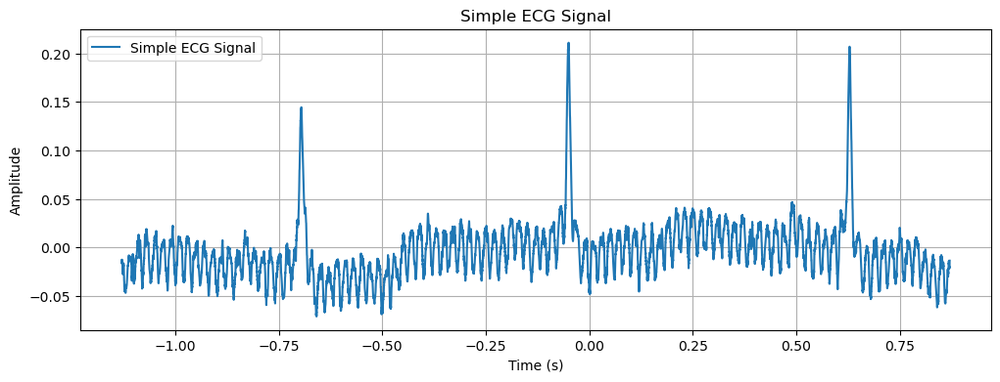

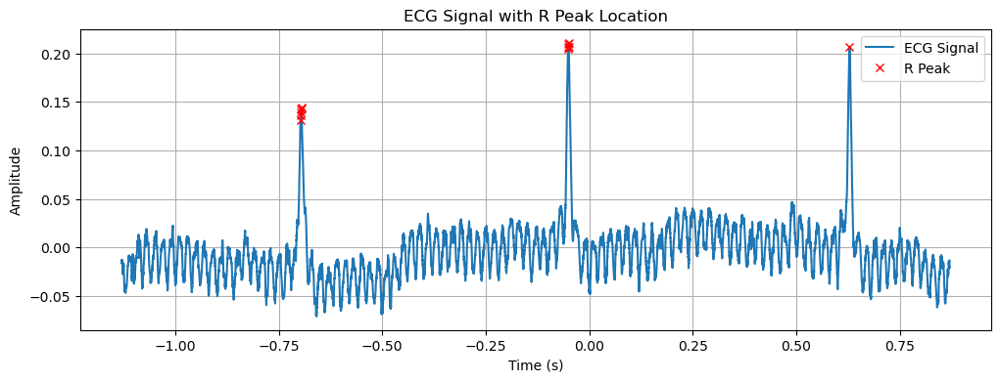

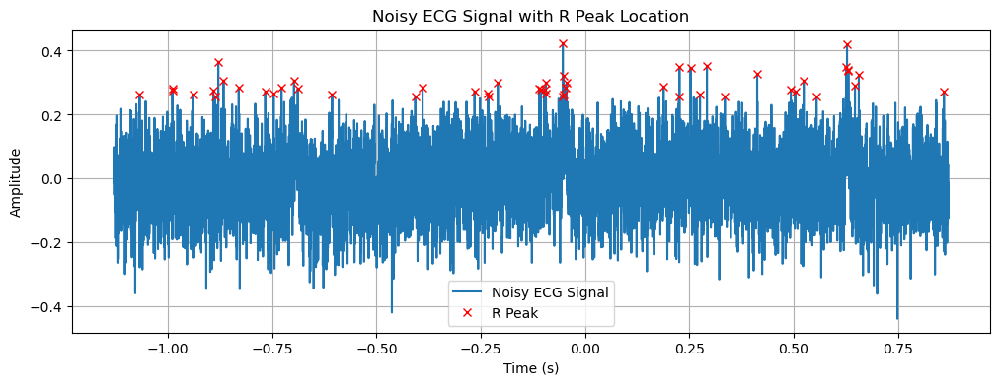

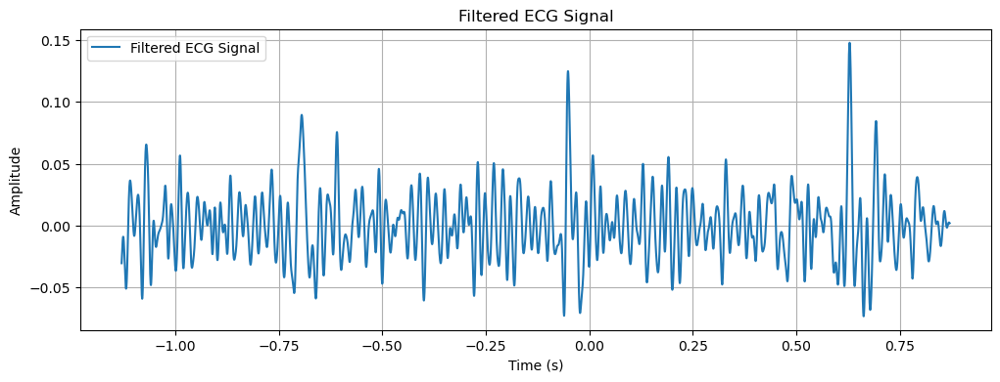

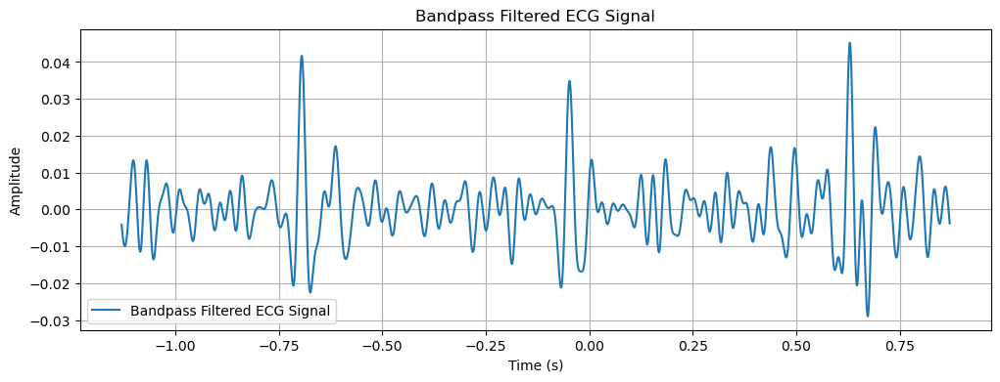

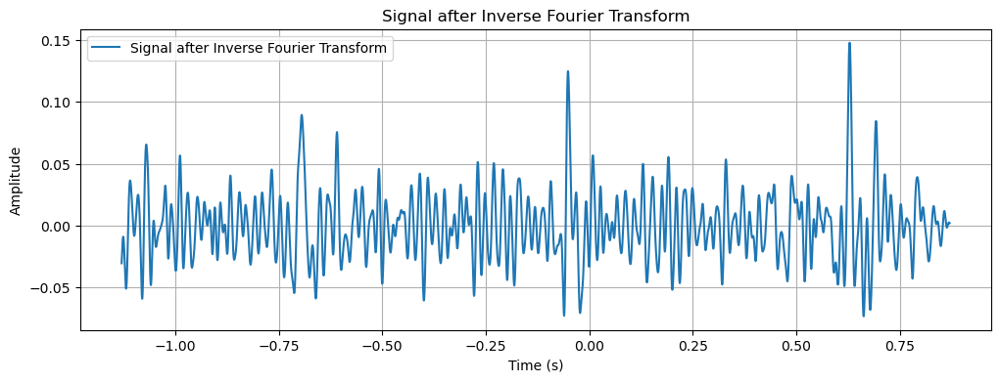

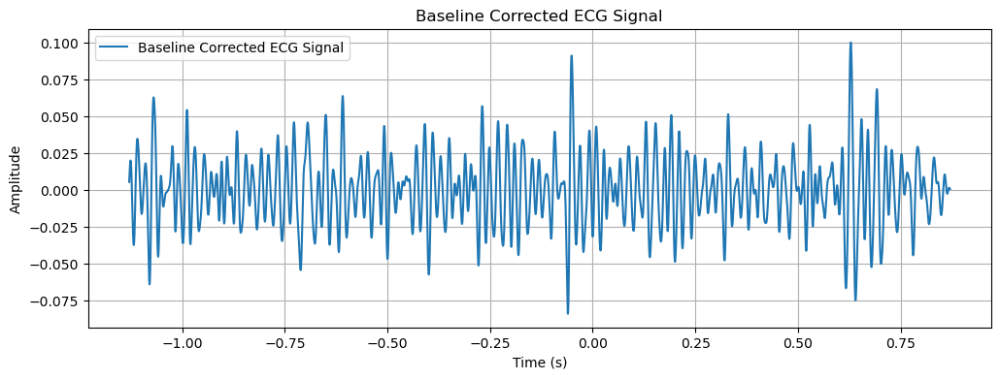

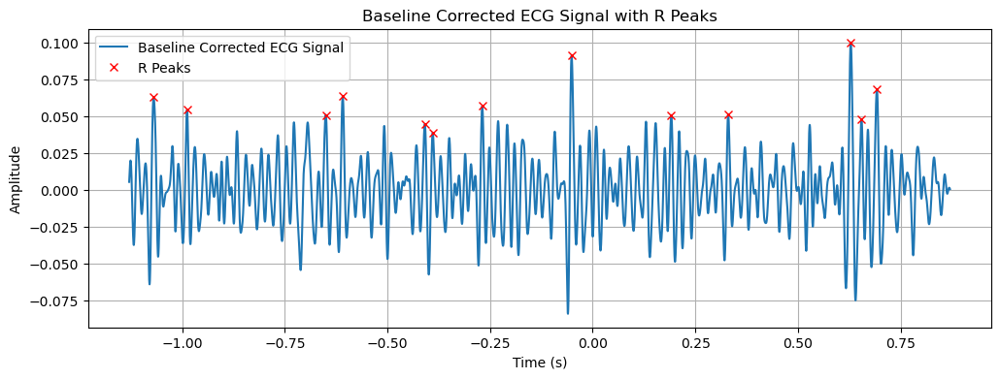

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, butter, filtfilt
from scipy.fft import fft, ifft
import pandas as pd

# Load the ECG signal
ecg_table = pd.read_csv("/home/nalin/Downloads/ecg(1).csv")
ecg = ecg_table['Channel 1 (V)']
time = ecg_table['Time (s)']

# Plot simple ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='Simple ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Simple ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Compute and show the location of the R peak
peaks, _ = find_peaks(ecg, height=0.6 * np.max(ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, ecg, label='ECG Signal')
plt.plot(time[peaks], ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()

# Add noise to the ECG signal
noise_level = 0.1
noisy_ecg = ecg + np.random.normal(0, noise_level, len(ecg))


# Compute and show the location of the R peak in the noisy ECG signal
peaks, _ = find_peaks(noisy_ecg, height=0.6 * np.max(noisy_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, noisy_ecg, label='Noisy ECG Signal')
plt.plot(time[peaks], noisy_ecg[peaks], 'x', color='red', label='R Peak')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Noisy ECG Signal with R Peak Location')
plt.legend()
plt.grid(True)
plt.show()


# Butterworth filter
def butterworth_filter(signal, low_cut, high_cut, Fs):
    Bw = [low_cut / (Fs / 2), high_cut / (Fs / 2)]
    b, a = butter(N=3, Wn=Bw, btype='band')
    return filtfilt(b, a, signal)

# Apply the Butterworth filter to the noisy ECG signal
filtered_ecg = butterworth_filter(noisy_ecg, low_cut=10, high_cut=80, Fs=1/(time[1]-time[0]))

# Plot the filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, filtered_ecg, label='Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Fourier Transform
fft_ecg = fft(filtered_ecg)

# Bandpass filter in the frequency domain
def bandpass_filter_freq(signal, low_cut, high_cut, Fs):
    freqs = np.fft.fftfreq(len(signal), 1/Fs)
    mask = (freqs >= low_cut) & (freqs <= high_cut)
    return ifft(fft(signal) * mask).real

# Apply the bandpass filter in the frequency domain
bandpass_filtered_ecg = bandpass_filter_freq(filtered_ecg, low_cut=10, high_cut=40, Fs=1/(time[1]-time[0]))

# Plot the bandpass filtered ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, bandpass_filtered_ecg, label='Bandpass Filtered ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Bandpass Filtered ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Inverse Fourier Transform
inverse_fft_filtered_ecg = ifft(fft(filtered_ecg)).real

# Plot the signal after inverse Fourier Transform
plt.figure(figsize=(12, 4))
plt.plot(time, inverse_fft_filtered_ecg, label='Signal after Inverse Fourier Transform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Signal after Inverse Fourier Transform')
plt.legend()
plt.grid(True)
plt.show()

# Base-line correction
def baseline_correction(signal, window_size):
    b, a = butter(N=5, Wn=0.01, btype='high')
    return filtfilt(b, a, signal)

baseline_corrected_ecg = baseline_correction(inverse_fft_filtered_ecg, window_size=5)

# Plot the baseline corrected ECG signal
plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal')
plt.legend()
plt.grid(True)
plt.show()

# Find R Peaks
THETA = 0.9
peaks_corrected, _ = find_peaks(x=baseline_corrected_ecg, prominence=THETA * np.max(baseline_corrected_ecg))

plt.figure(figsize=(12, 4))
plt.plot(time, baseline_corrected_ecg, label='Baseline Corrected ECG Signal')
plt.plot(time[peaks_corrected], baseline_corrected_ecg[peaks_corrected], 'x', color='red', label='R Peaks')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Baseline Corrected ECG Signal with R Peaks')
plt.legend()
plt.grid(True)
plt.show()


TypeError: object of type 'NoneType' has no len()

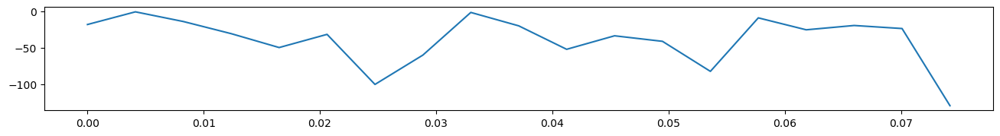

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, freqz

# Assuming this is your function to apply Butterworth filters
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    # Code to apply Butterworth filters
    pass

# Assuming this is your directory containing EEG data files
file_dir = 'path/to/your/eeg/data/directory'

# Define frequency bands
bands = {'Delta': (0.5, 4),
          'Theta': (4, 8),
          'Alpha': (8, 12),
          'Beta': (12, 30)}

# Assuming this is your file name
file_name = 'your_eeg_file_name'

# Filter and plot for each frequency band
for band, (lowcut, highcut) in bands.items():
    # Normalize cutoff frequencies by Nyquist frequency
    lowcut = lowcut / (fs / 2)
    highcut = highcut / (fs / 2)

    # Filter EEG data
    filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

    # Plot time domain
    plt.figure(figsize=(16, 6))
    plt.subplot(3, 1, 1)
    plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0], label='Original EEG Data')
    plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data, label='Filtered EEG Data')
    plt.title('EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.grid(True)

    # Plot frequency domain
    plt.subplot(3, 1, 2)
    f, a = butter_bandpass(lowcut, highcut, fs, order=5)
    plt.semilogx(f, a, label='Filter in ' + band + ' Band')
    plt.title('Filter Transfer Function in ' + band + ' Band')
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.legend()
    plt.grid(True)

    # Plot filtered frequency domain
    plt.subplot(3, 1, 3)
    plt.magnitude_spectrum(eeg_data[0], Fs=fs, label='Original EEG Data')
    plt.magnitude_spectrum(filtered_data, Fs=fs, label='Filtered EEG Data')
    plt.title('Filtered EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()

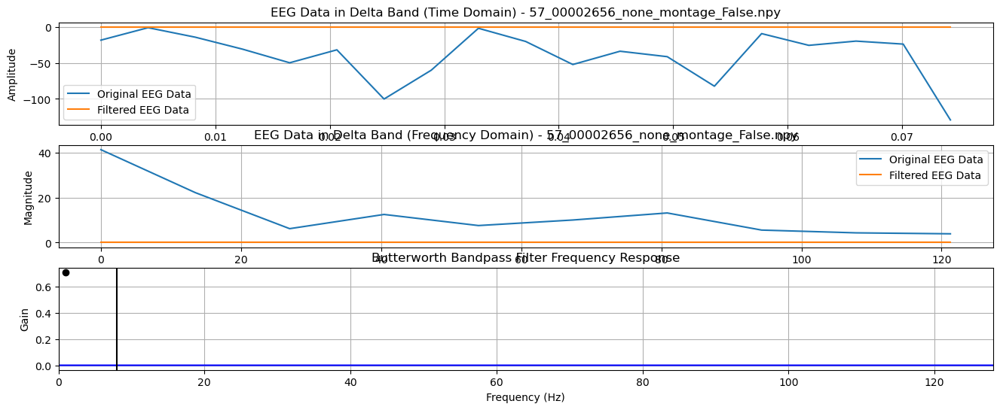

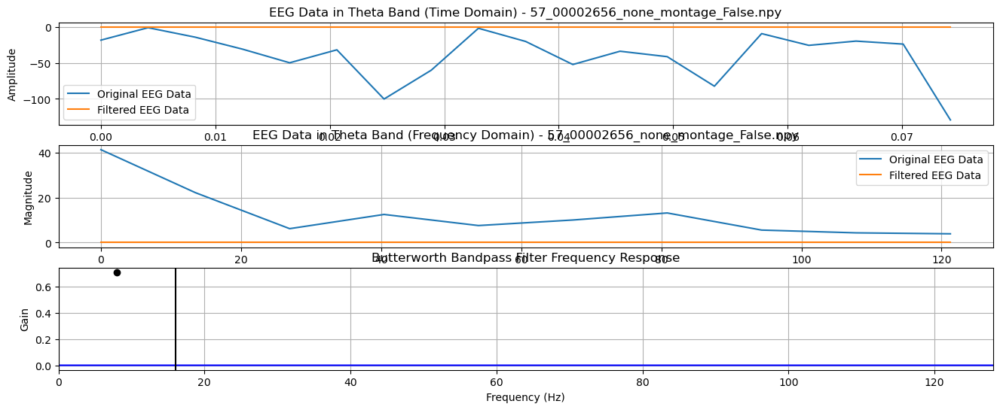

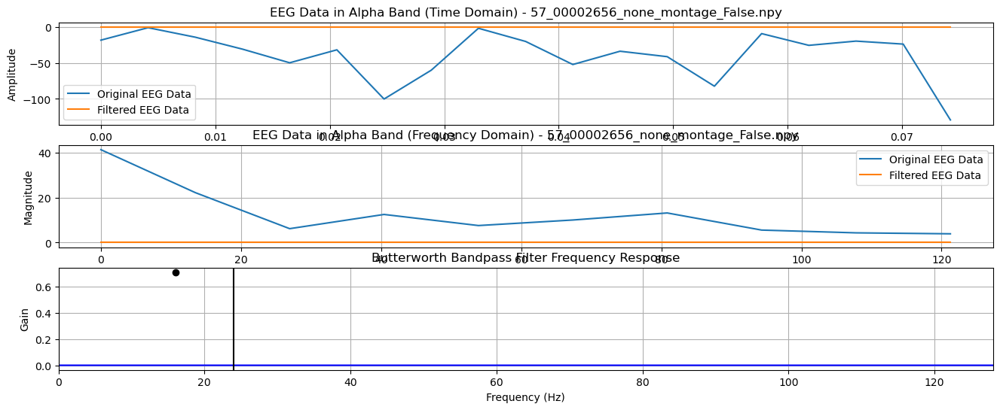

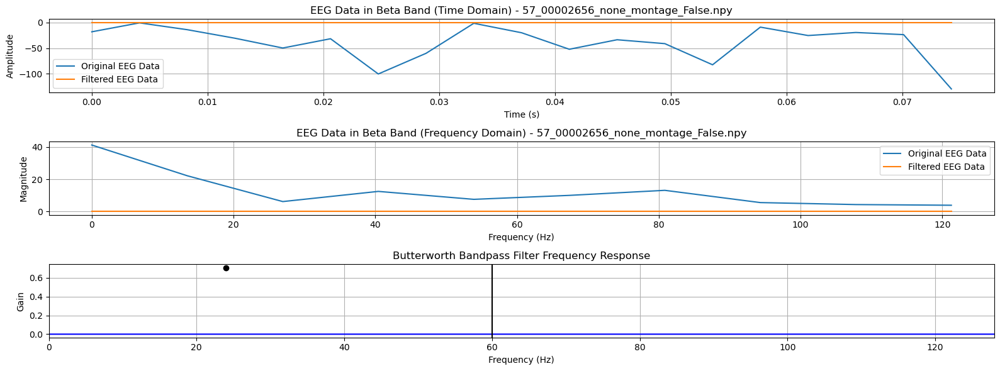

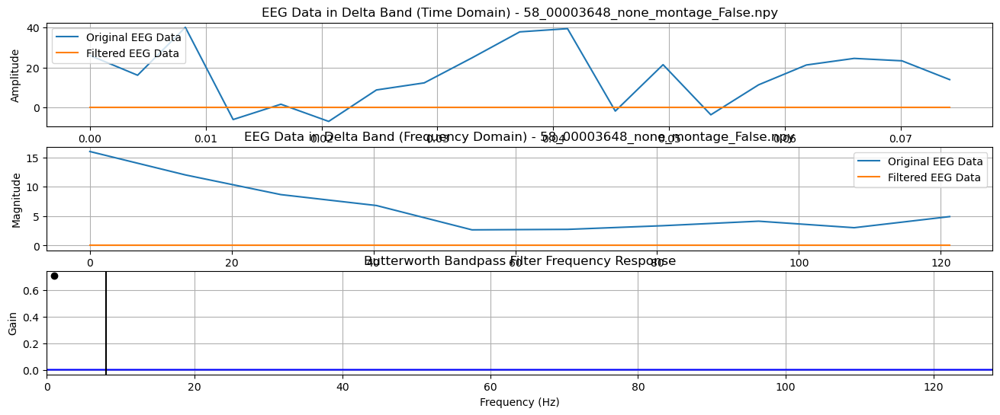

...

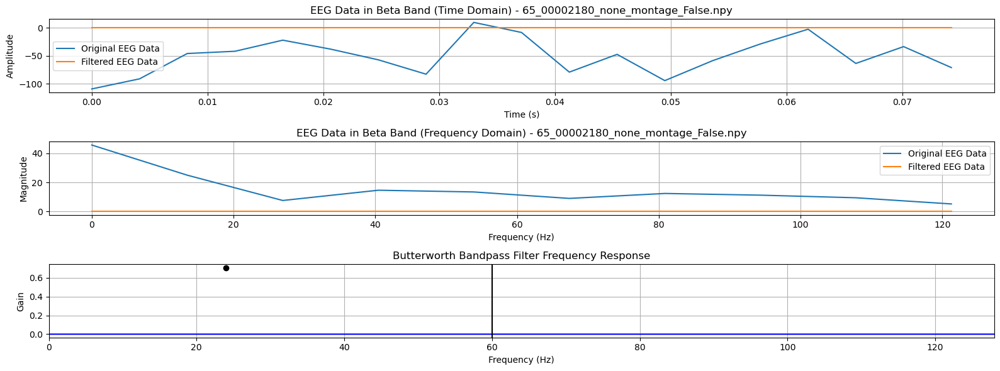

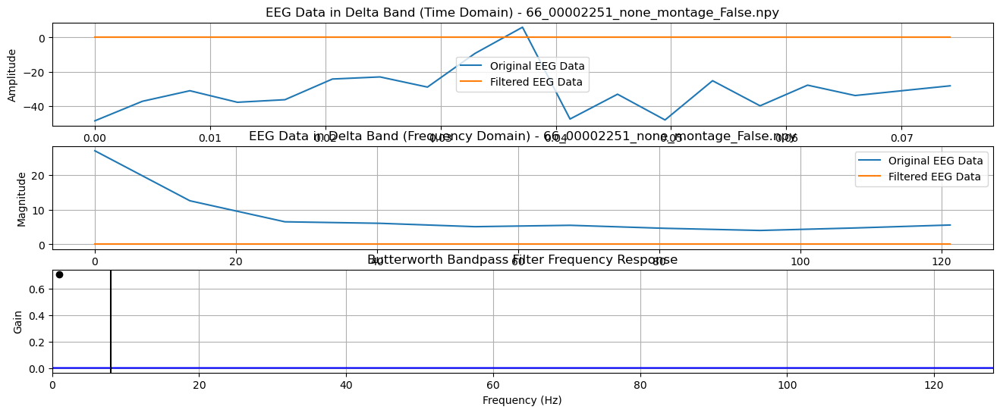

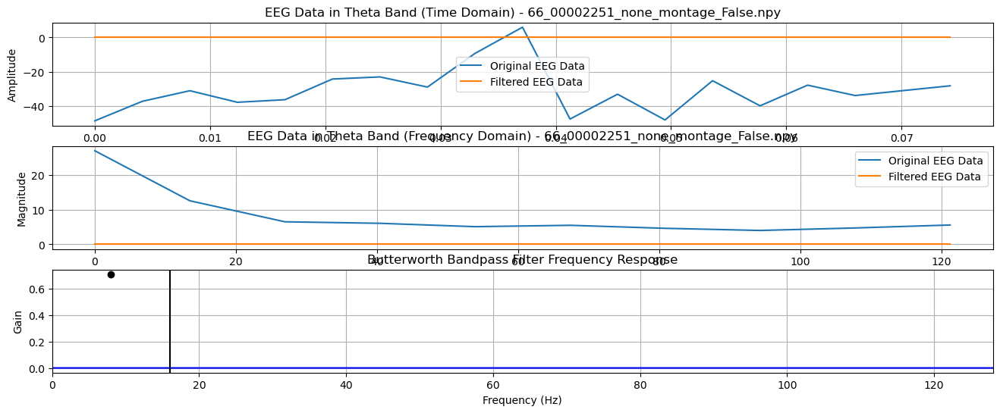

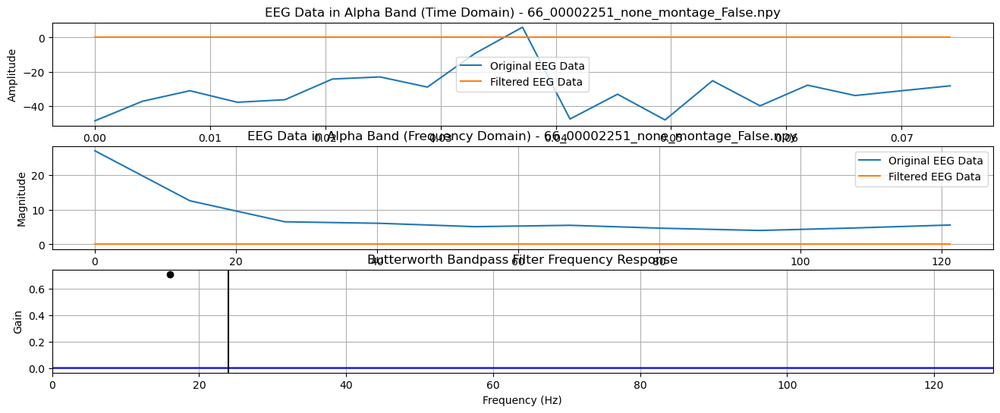

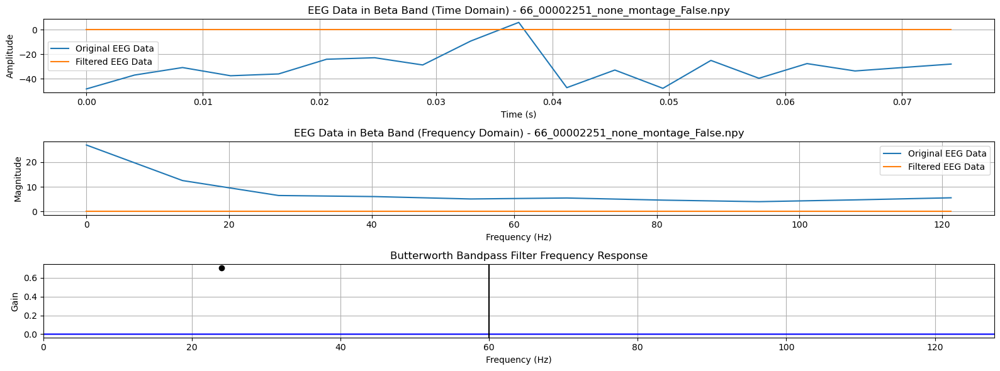

In [34]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz
import os

# Function to create Butterworth filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply filter to data
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    padlen = max(0, len(data) - 1)  # Adjust padding length dynamically
    y = filtfilt(b, a, data, padlen=padlen)
    return y

# Define frequency bands (in Hz)
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 12),
    'Beta': (12, 30)
}

# Specify the directory containing the EEG data files
data_directory = '/home/nalin/Downloads/eeg_data_files-20240411'

# Iterate through the files in the specified directory
for file_name in sorted(os.listdir(data_directory)):
    if file_name.endswith('.npy'):
        file_path = os.path.join(data_directory, file_name)
        eeg_data = np.load(file_path).T  # Transpose to read rows as channels

        # Assuming the data is sampled at a constant frequency
        # You may need additional information about the sampling rate from the data provider
        # For this example, let's assume a sampling rate of 256 Hz
        fs = 256

        # Filter and plot for each frequency band
        for band, (lowcut, highcut) in bands.items():
            # Normalize cutoff frequencies by Nyquist frequency
            lowcut = lowcut / (fs / 2)
            highcut = highcut / (fs / 2)

            # Filter EEG data
            filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

            # Plot time domain
            plt.figure(figsize=(16, 6))
            plt.subplot(3, 1, 1)
            plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0], label='Original EEG Data')
            plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data, label='Filtered EEG Data')
            plt.title('EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')
            plt.legend()
            plt.grid(True)

            # Plot frequency domain
            plt.subplot(3, 1, 2)
            plt.magnitude_spectrum(eeg_data[0], Fs=fs, label='Original EEG Data')
            plt.magnitude_spectrum(filtered_data, Fs=fs, label='Filtered EEG Data')
            plt.title('EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')
            plt.legend()
            plt.grid(True)

            # Plot filter frequency response
            plt.subplot(3, 1, 3)
            b, a = butter_bandpass(lowcut, highcut, fs, order=5)
            w, h = freqz(b, a, worN=8000)
            plt.plot(0.5 * fs * w / np.pi, np.abs(h), 'b')
            plt.plot(lowcut * fs, 0.5 * np.sqrt(2), 'ko')
            plt.axvline(highcut * fs, color='k')
            plt.xlim(0, 0.5 * fs)
            plt.title('Butterworth Bandpass Filter Frequency Response')
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Gain')
            plt.grid(True)

        plt.tight_layout()
        plt.show()


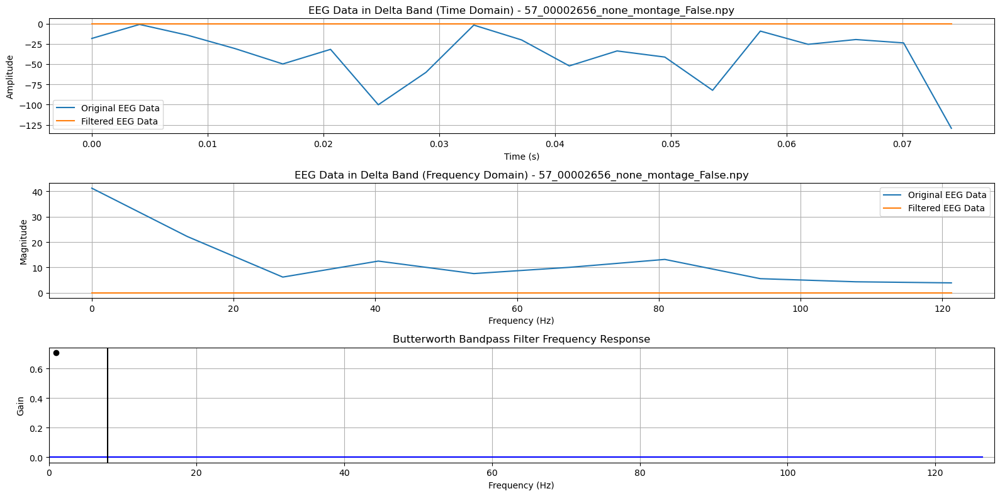

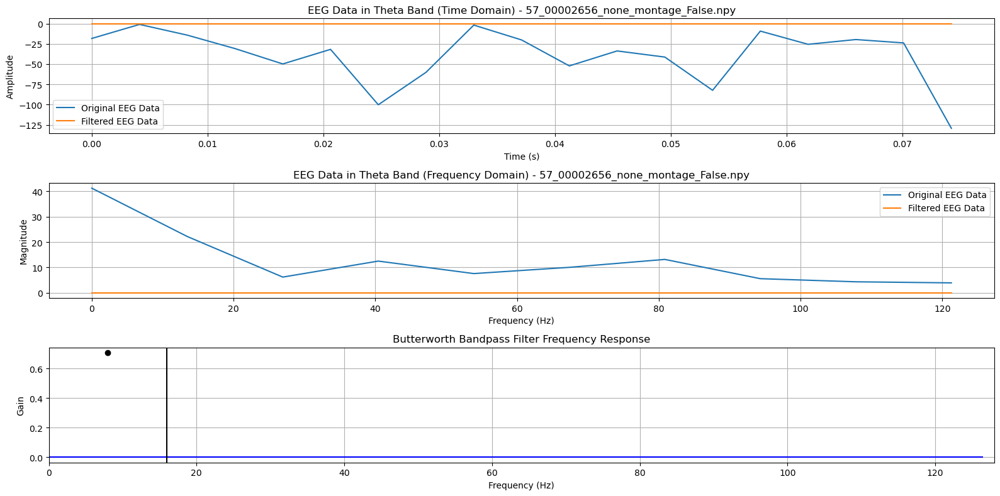

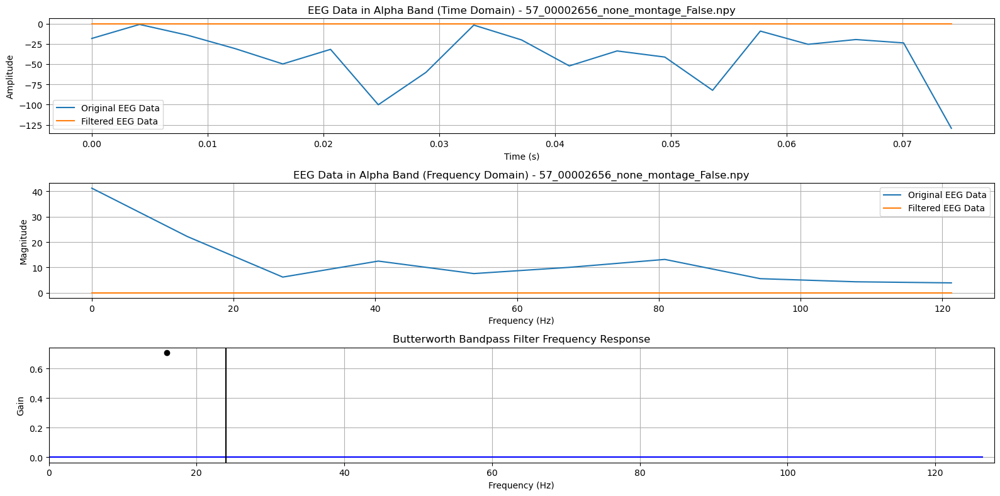

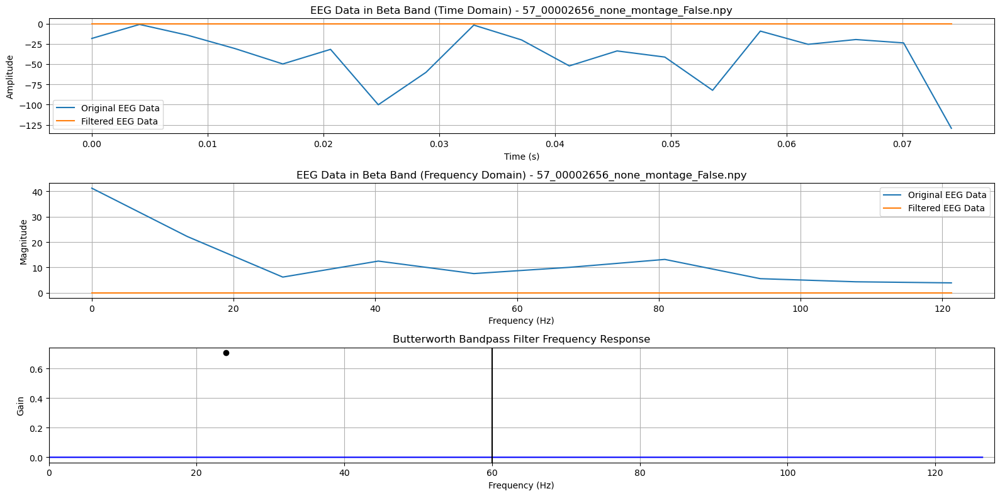

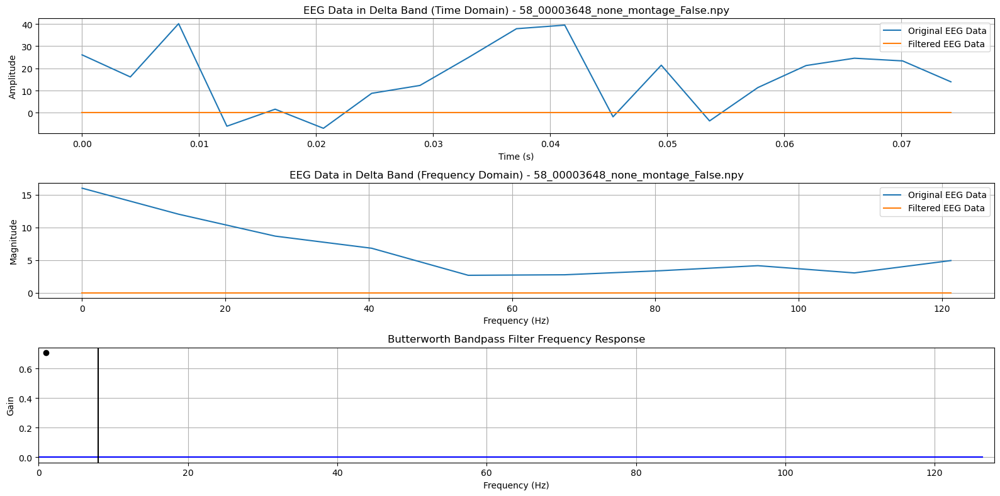

...

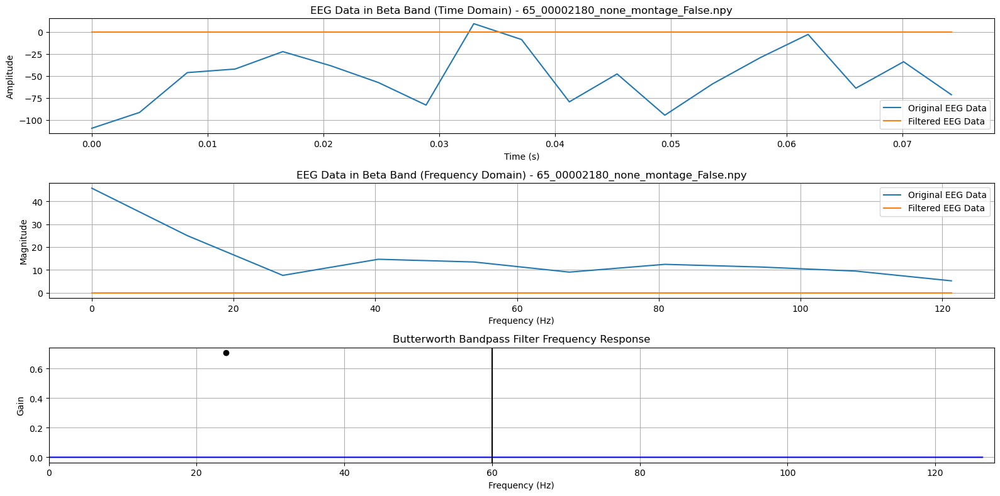

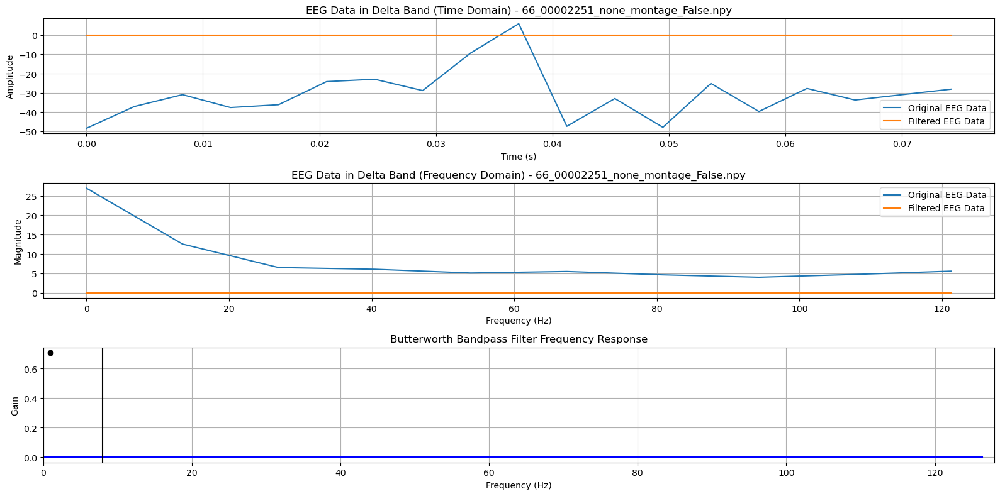

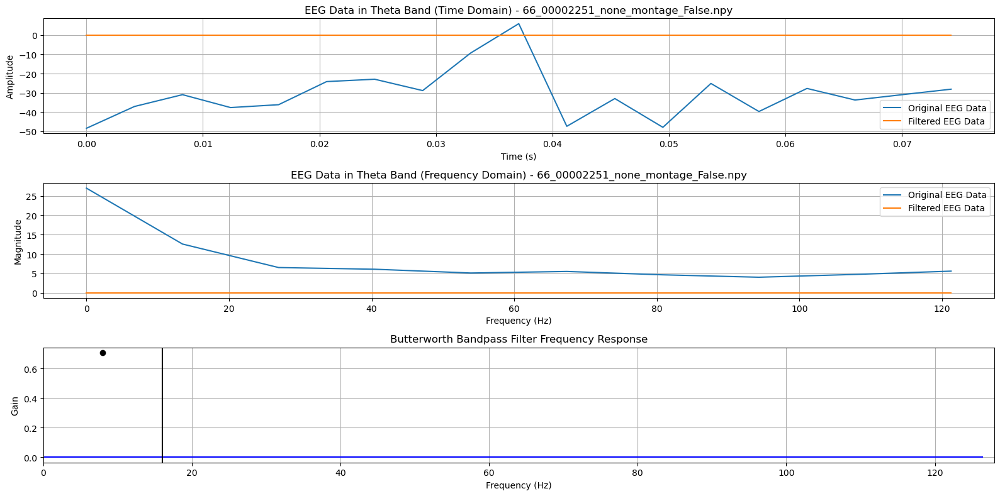

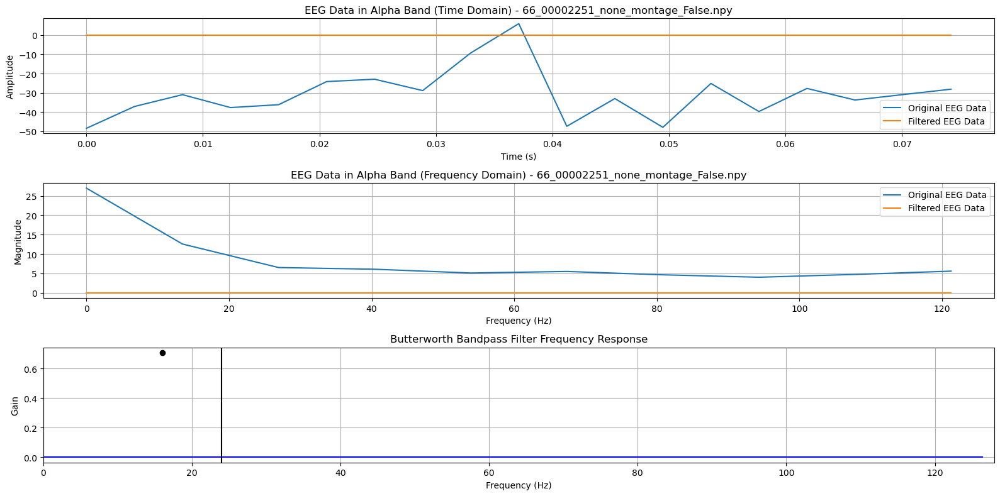

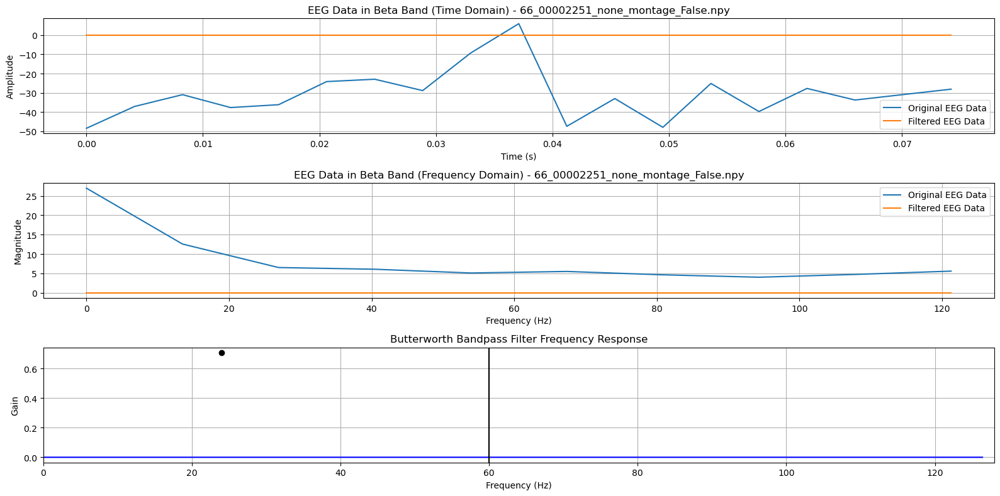

In [36]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz
import os

# Function to create Butterworth filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply filter to data
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    padlen = max(0, len(data) - 1)  # Adjust padding length dynamically
    y = filtfilt(b, a, data, padlen=padlen)
    return y

# Define frequency bands (in Hz)
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 12),
    'Beta': (12, 30)
}

# Specify the directory containing the EEG data files
data_directory = '/home/nalin/Downloads/eeg_data_files-20240411'

# Iterate through the files in the specified directory
for file_name in sorted(os.listdir(data_directory)):
    if file_name.endswith('.npy'):
        file_path = os.path.join(data_directory, file_name)
        eeg_data = np.load(file_path).T  # Transpose to read rows as channels

        # Assuming the data is sampled at a constant frequency
        # You may need additional information about the sampling rate from the data provider
        # For this example, let's assume a sampling rate of 256 Hz
        fs = 256

        # Filter and plot for each frequency band
        for band, (lowcut, highcut) in bands.items():
            # Normalize cutoff frequencies by Nyquist frequency
            lowcut = lowcut / (fs / 2)
            highcut = highcut / (fs / 2)

            # Filter EEG data
            filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

            # Plot time domain
            plt.figure(figsize=(16, 8))
            plt.subplot(3, 1, 1)
            plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0], label='Original EEG Data')
            plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data, label='Filtered EEG Data')
            plt.title('EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')
            plt.legend()
            plt.grid(True)

            # Plot frequency domain (FFT)
            plt.subplot(3, 1, 2)
            plt.magnitude_spectrum(eeg_data[0], Fs=fs, label='Original EEG Data')
            plt.magnitude_spectrum(filtered_data, Fs=fs, label='Filtered EEG Data')
            plt.title('EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')
            plt.legend()
            plt.grid(True)

            # Plot filter frequency response
            plt.subplot(3, 1, 3)
            b, a = butter_bandpass(lowcut, highcut, fs, order=5)
            w, h = freqz(b, a, worN=8000)
            plt.plot(0.5 * fs * w / np.pi, np.abs(h), 'b')
            plt.plot(lowcut * fs, 0.5 * np.sqrt(2), 'ko')
            plt.axvline(highcut * fs, color='k')
            plt.xlim(0, 0.5 * fs)
            plt.title('Butterworth Bandpass Filter Frequency Response')
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Gain')
            plt.grid(True)

            plt.tight_layout()
            plt.show()


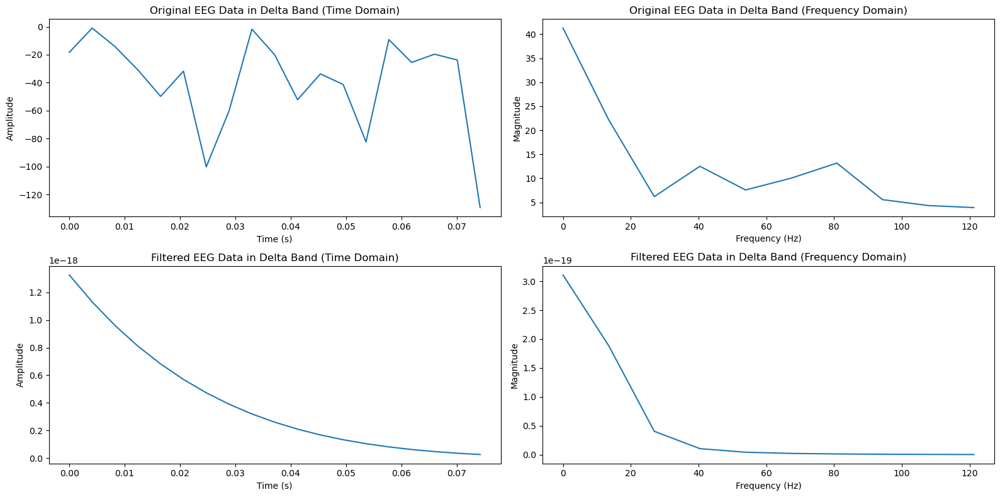

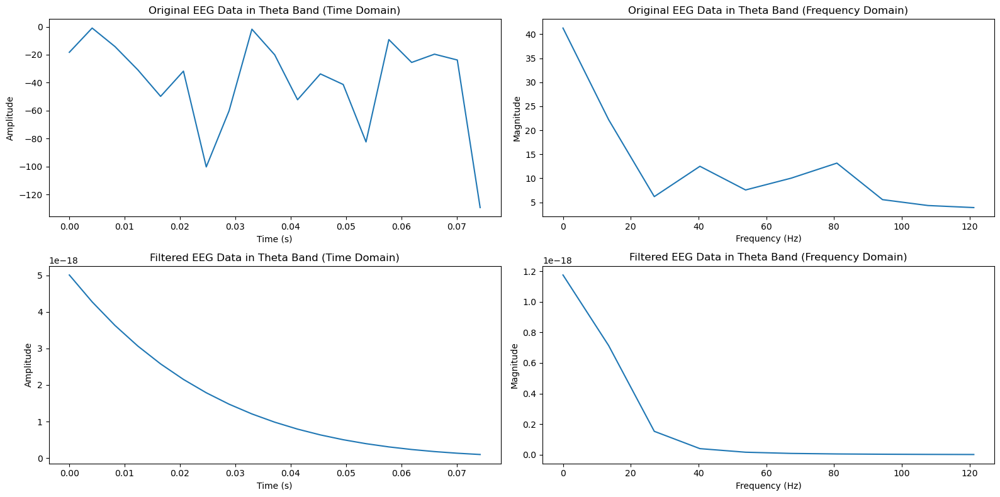

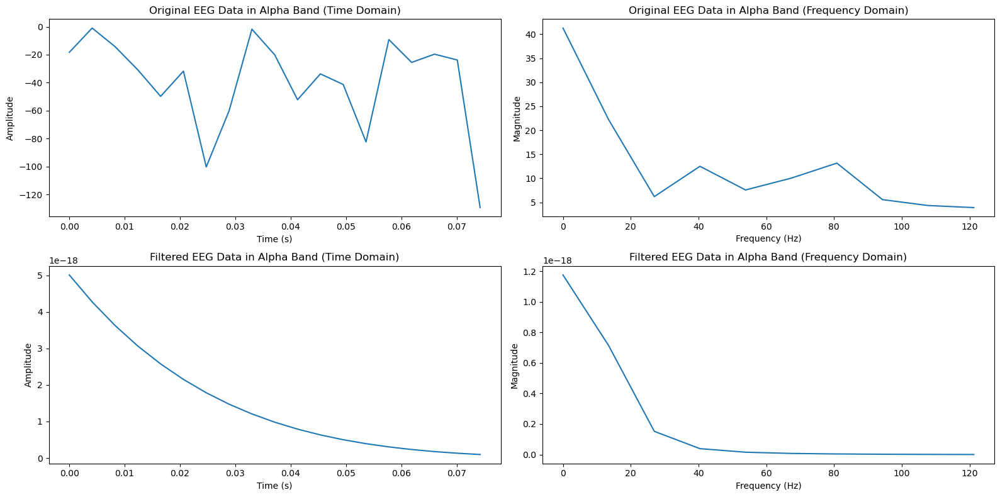

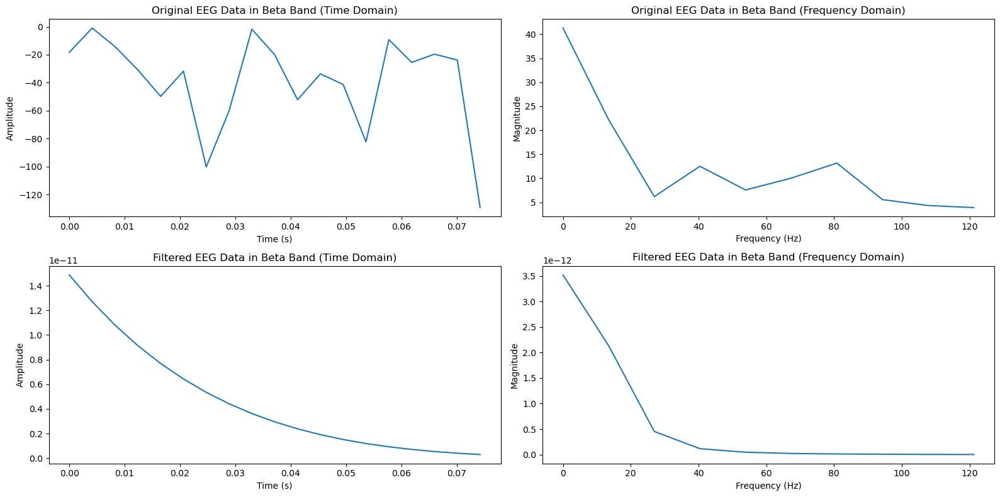

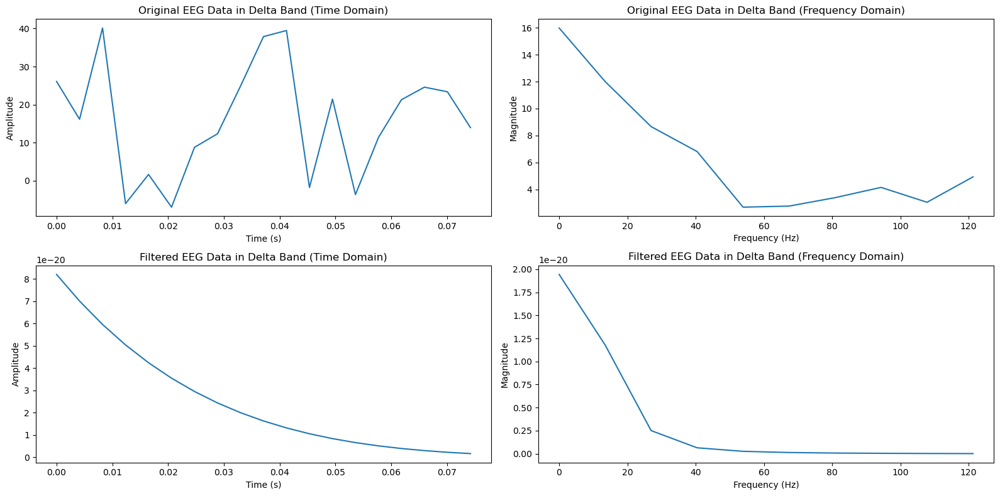

...

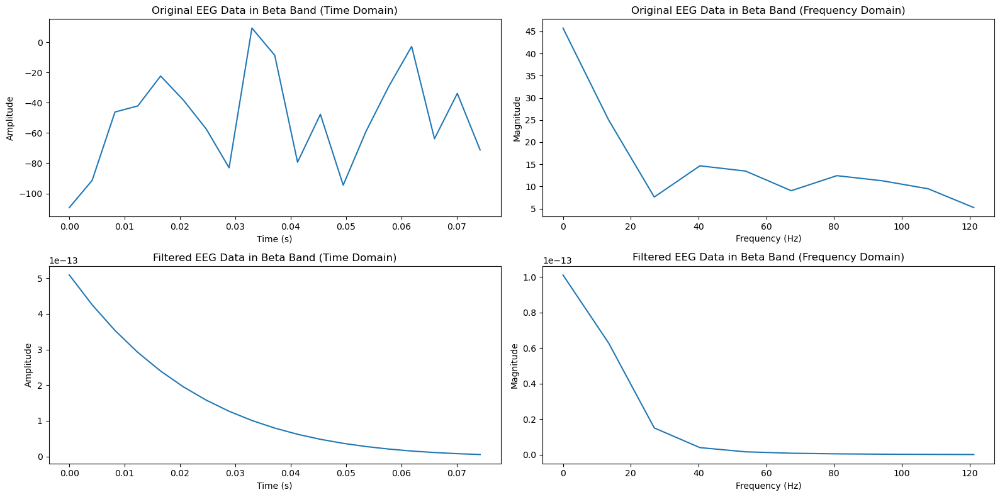

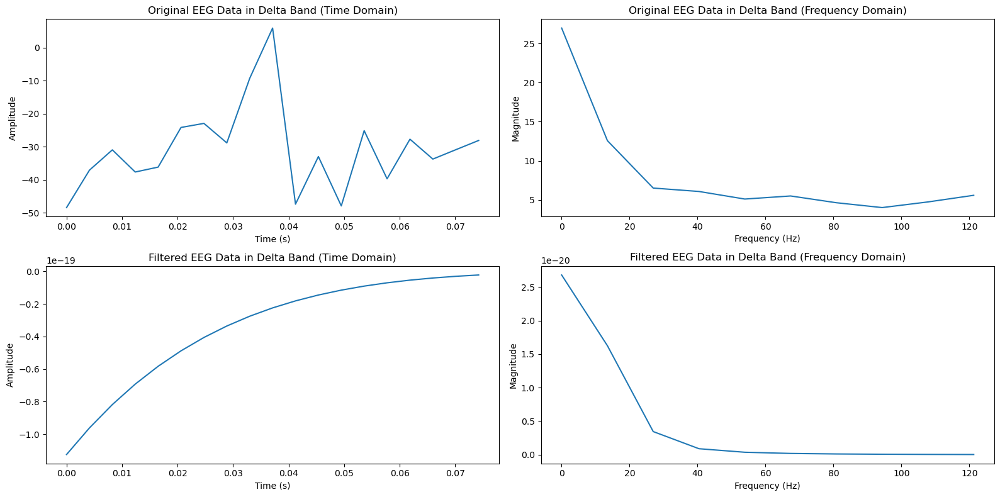

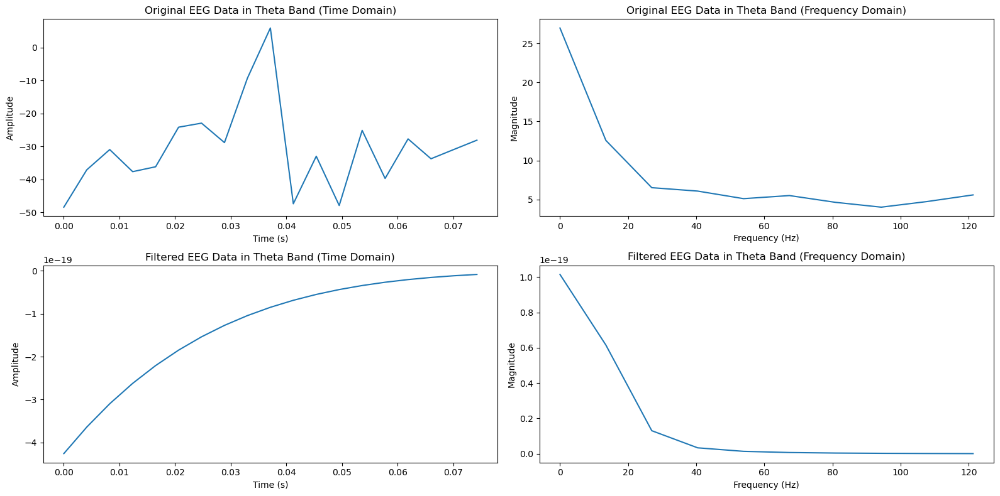

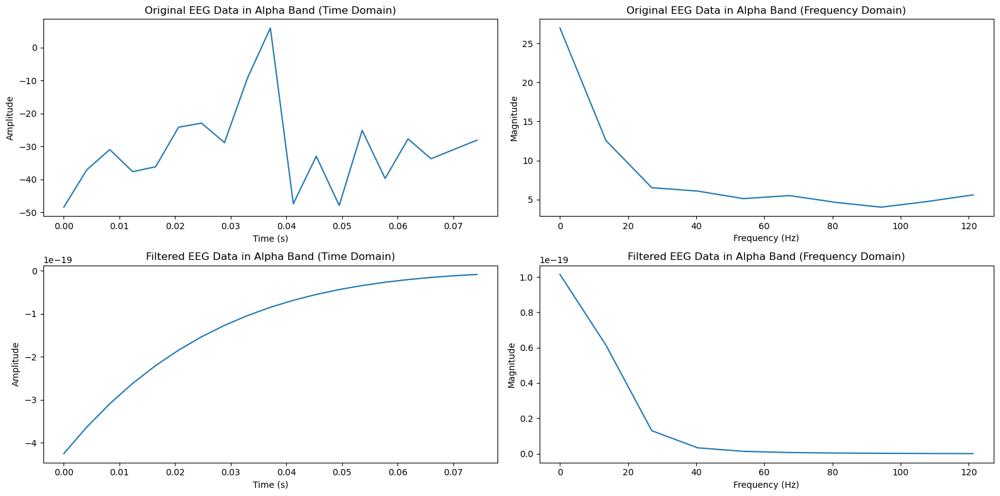

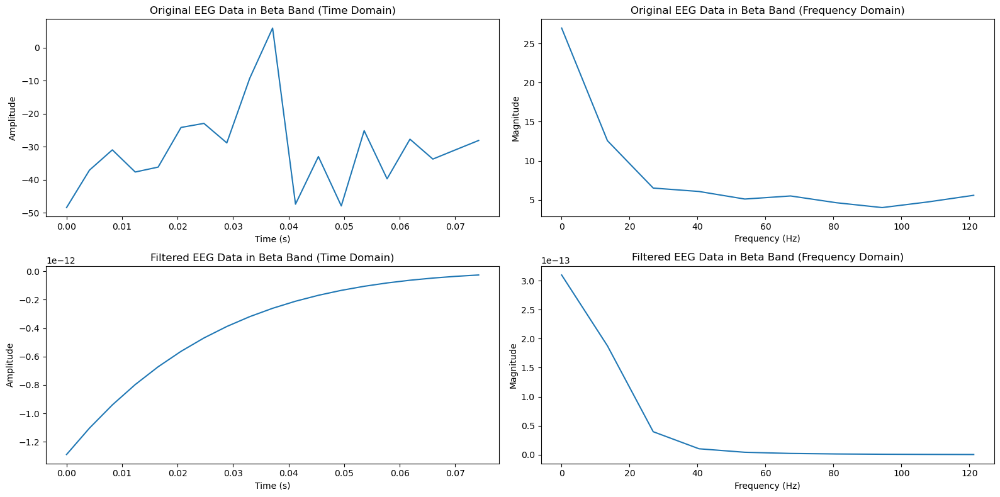

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz
import os

# Function to create Butterworth filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply filter to data
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    padlen = max(0, len(data) - 1)  # Adjust padding length dynamically
    y = filtfilt(b, a, data, padlen=padlen)
    return y

# Define frequency bands (in Hz)
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 12),
    'Beta': (12, 30)
}

# Specify the directory containing the EEG data files
data_directory = '/home/nalin/Downloads/eeg_data_files-20240411'

# Iterate through the files in the specified directory
for file_name in sorted(os.listdir(data_directory)):
    if file_name.endswith('.npy'):
        file_path = os.path.join(data_directory, file_name)
        eeg_data = np.load(file_path).T  # Transpose to read rows as channels

        # Assuming the data is sampled at a constant frequency
        # You may need additional information about the sampling rate from the data provider
        # For this example, let's assume a sampling rate of 256 Hz
        fs = 256

        # Filter and plot for each frequency band
        for band, (lowcut, highcut) in bands.items():
            # Normalize cutoff frequencies by Nyquist frequency
            lowcut = lowcut / (fs / 2)
            highcut = highcut / (fs / 2)

            # Filter EEG data
            filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

            # Plot time and frequency domains for original and filtered signals
            plt.figure(figsize=(16, 8))
            
            # Plot original signal in time domain
            plt.subplot(2, 2, 1)
            plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0])
            plt.title('Original EEG Data in ' + band + ' Band (Time Domain)')
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')

            # Plot original signal in frequency domain
            plt.subplot(2, 2, 2)
            plt.magnitude_spectrum(eeg_data[0], Fs=fs)
            plt.title('Original EEG Data in ' + band + ' Band (Frequency Domain)')
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')

            # Plot filtered signal in time domain
            plt.subplot(2, 2, 3)
            plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data)
            plt.title('Filtered EEG Data in ' + band + ' Band (Time Domain)')
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')

            # Plot filtered signal in frequency domain
            plt.subplot(2, 2, 4)
            plt.magnitude_spectrum(filtered_data, Fs=fs)
            plt.title('Filtered EEG Data in ' + band + ' Band (Frequency Domain)')
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')

            plt.tight_layout()
            plt.show()


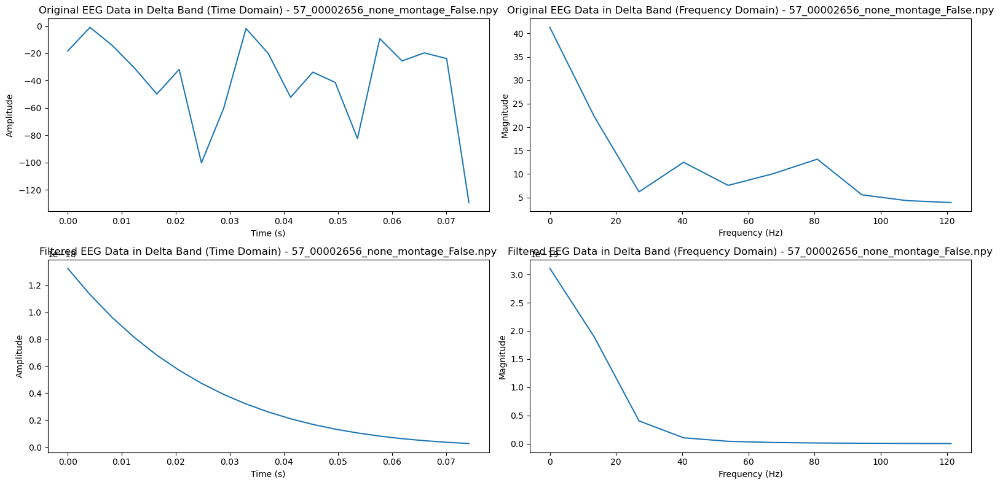

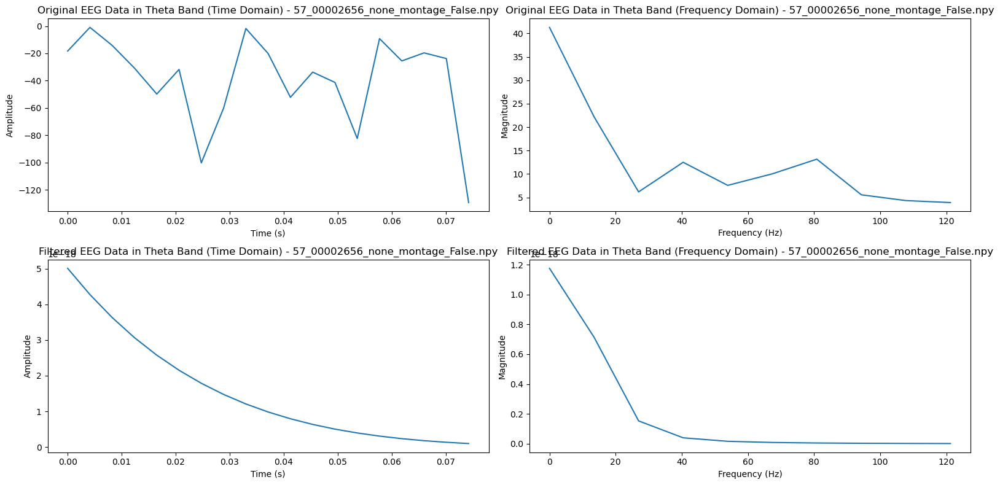

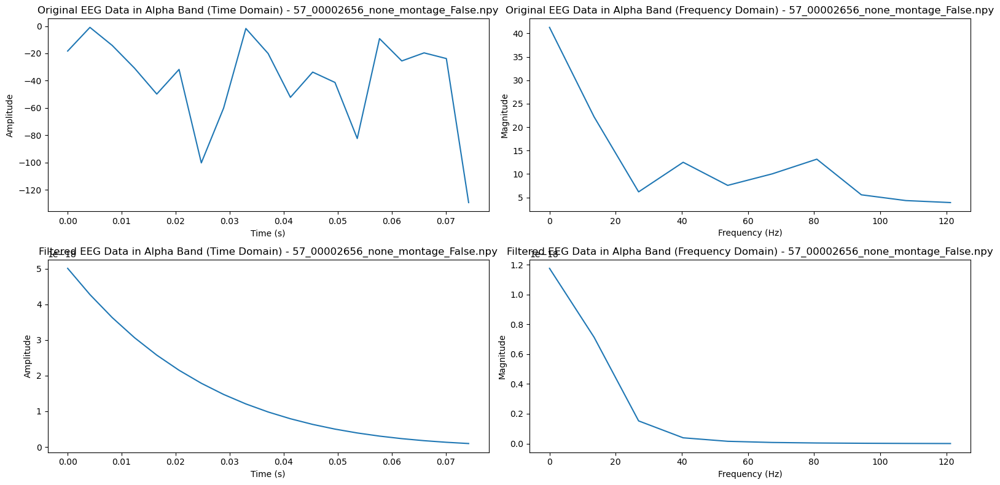

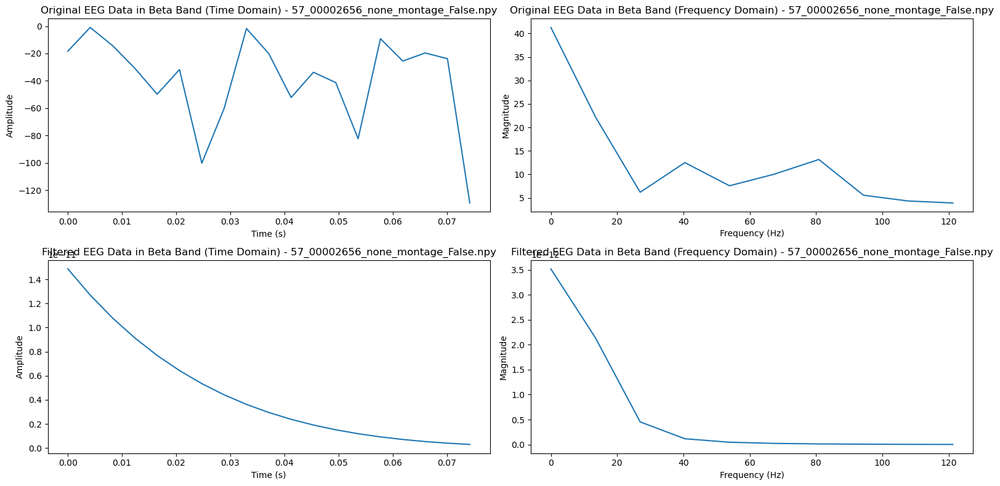

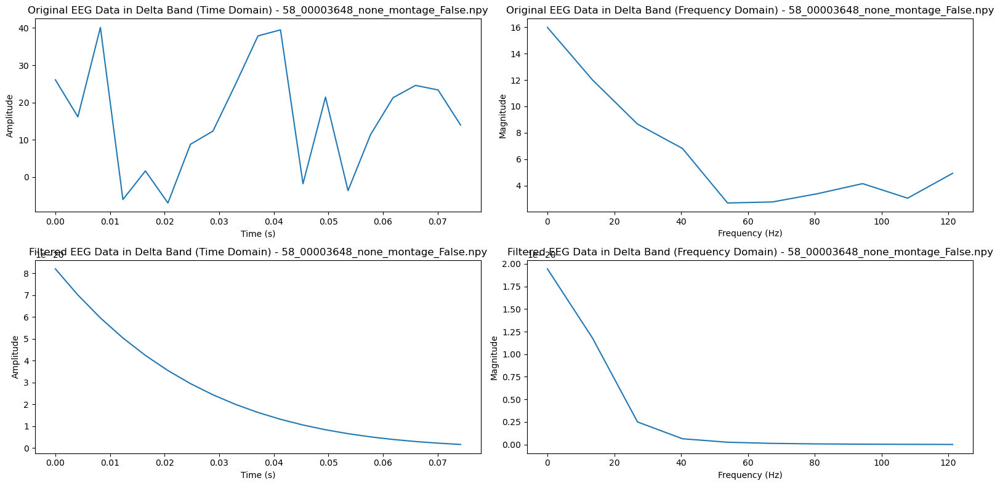

...

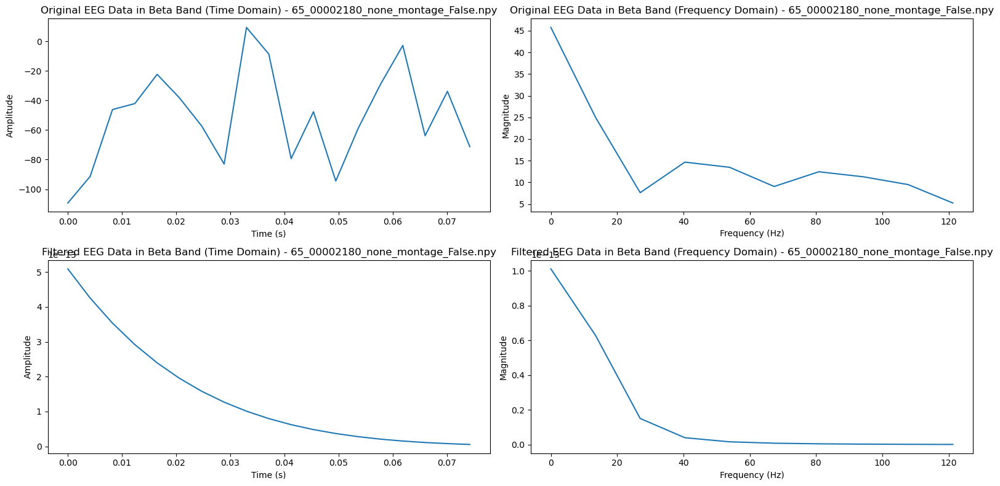

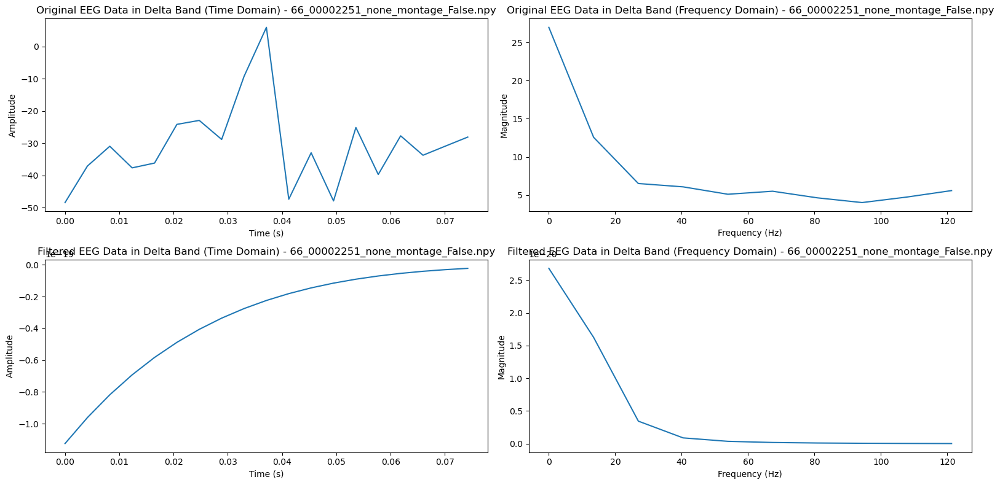

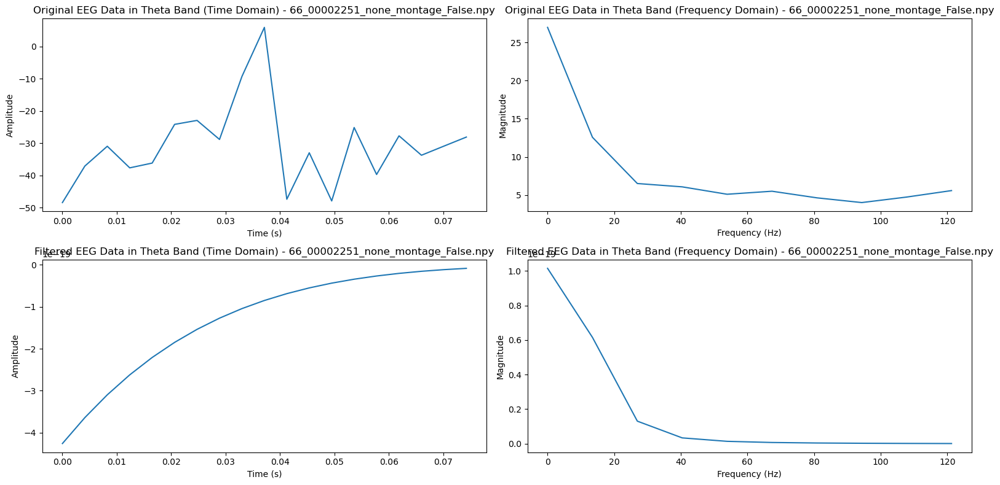

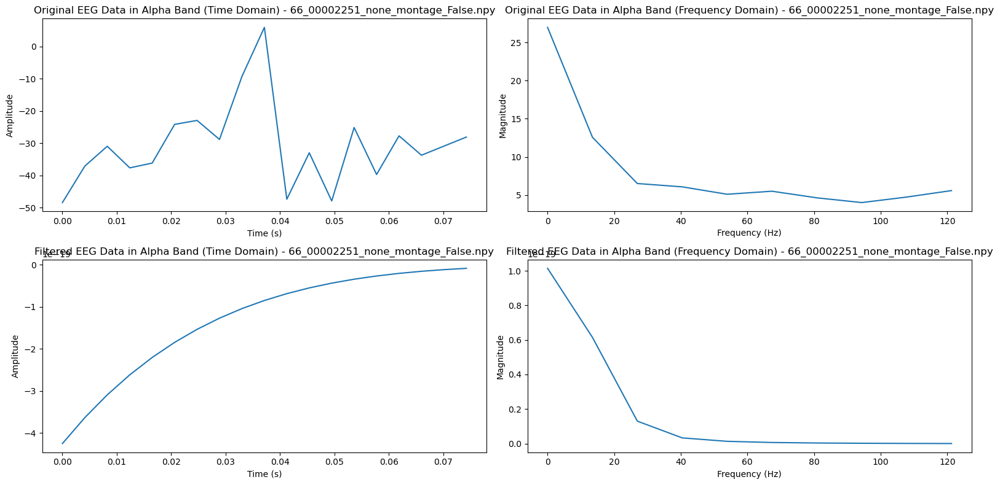

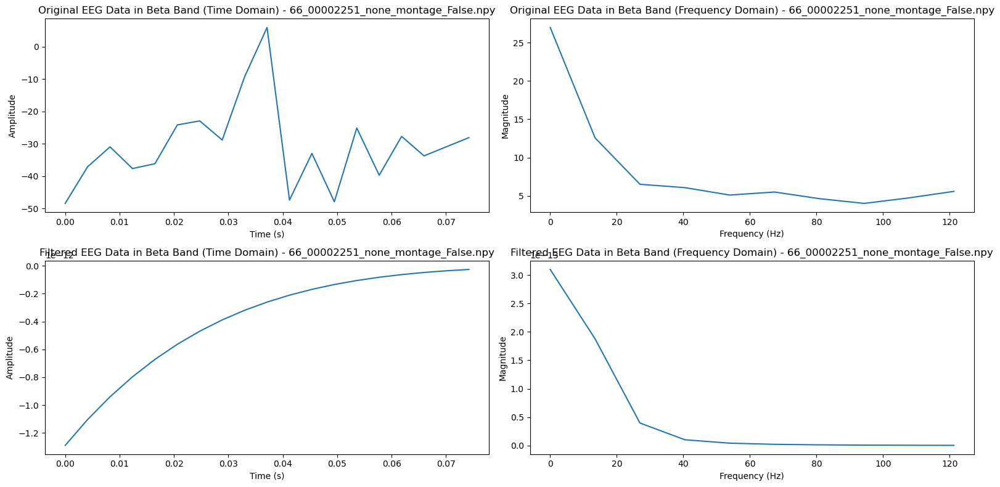

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz
import os

# Function to create Butterworth filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply filter to data
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    padlen = max(0, len(data) - 1)  # Adjust padding length dynamically
    y = filtfilt(b, a, data, padlen=padlen)
    return y

# Define frequency bands (in Hz)
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 12),
    'Beta': (12, 30)
}

# Specify the directory containing the EEG data files
data_directory = '/home/nalin/Downloads/eeg_data_files-20240411'

# Iterate through the files in the specified directory
for file_name in sorted(os.listdir(data_directory)):
    if file_name.endswith('.npy'):
        file_path = os.path.join(data_directory, file_name)
        eeg_data = np.load(file_path).T  # Transpose to read rows as channels

        # Assuming the data is sampled at a constant frequency
        # You may need additional information about the sampling rate from the data provider
        # For this example, let's assume a sampling rate of 256 Hz
        fs = 256

        # Filter and plot for each frequency band
        for band, (lowcut, highcut) in bands.items():
            # Normalize cutoff frequencies by Nyquist frequency
            lowcut = lowcut / (fs / 2)
            highcut = highcut / (fs / 2)

            # Filter EEG data
            filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

            # Plot time and frequency domains for original and filtered signals
            plt.figure(figsize=(16, 8))
            
            # Plot original signal in time domain
            plt.subplot(2, 2, 1)
            plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0])
            plt.title('Original EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')

            # Plot original signal in frequency domain
            plt.subplot(2, 2, 2)
            plt.magnitude_spectrum(eeg_data[0], Fs=fs)
            plt.title('Original EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')

            # Plot filtered signal in time domain
            plt.subplot(2, 2, 3)
            plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data)
            plt.title('Filtered EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')

            # Plot filtered signal in frequency domain
            plt.subplot(2, 2, 4)
            plt.magnitude_spectrum(filtered_data, Fs=fs)
            plt.title('Filtered EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')

            plt.tight_layout()
            plt.show()


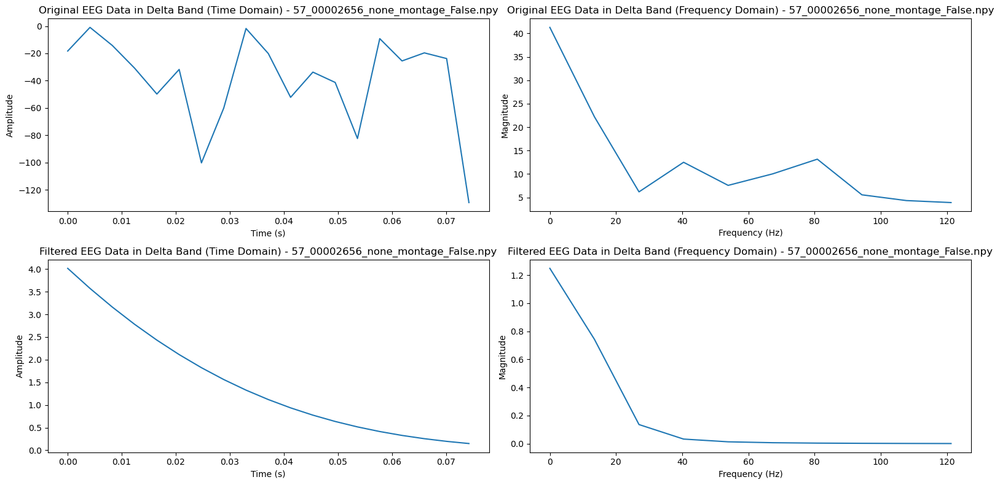

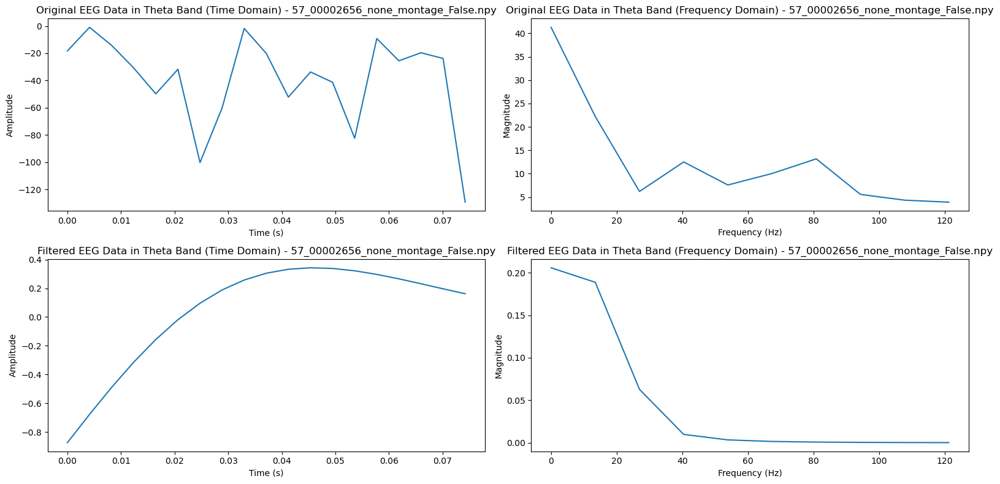

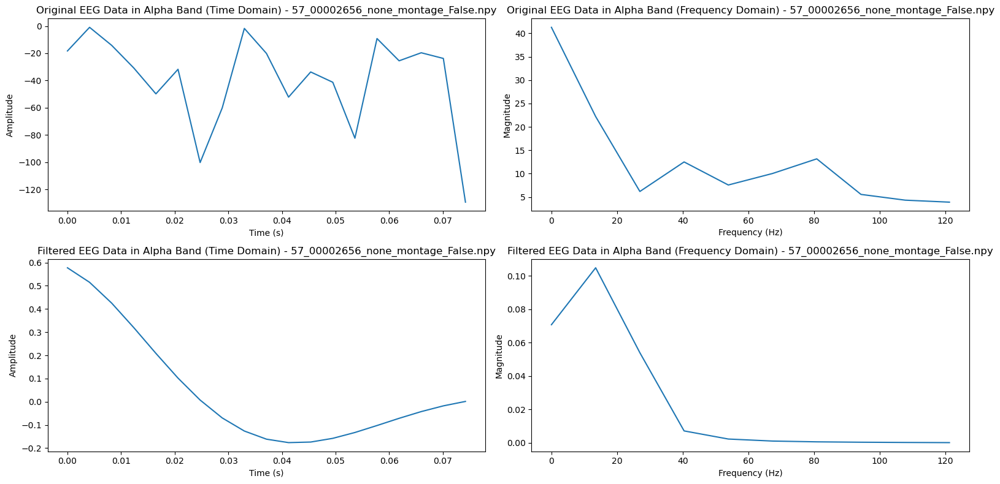

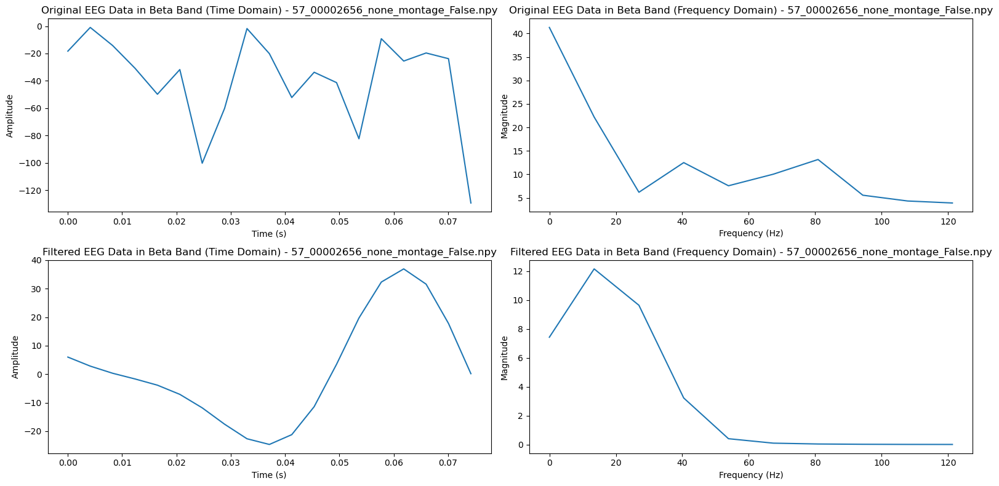

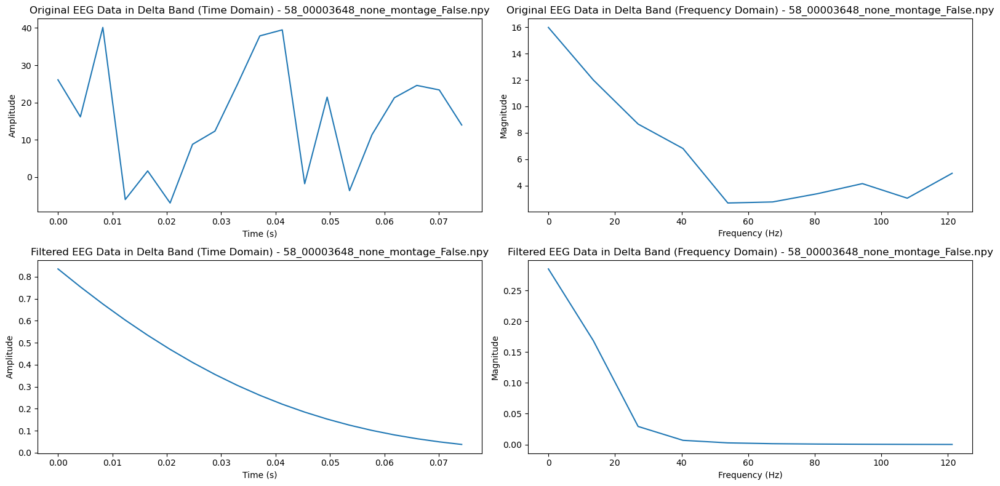

...

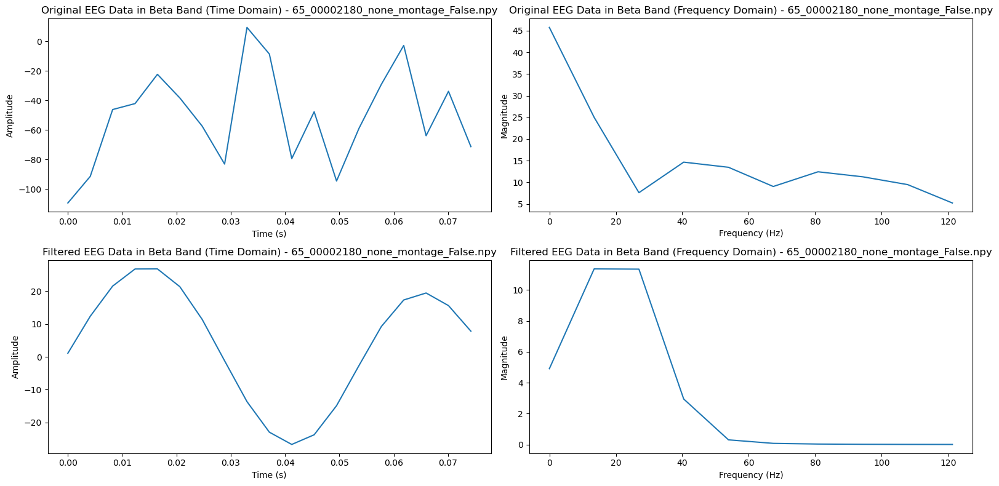

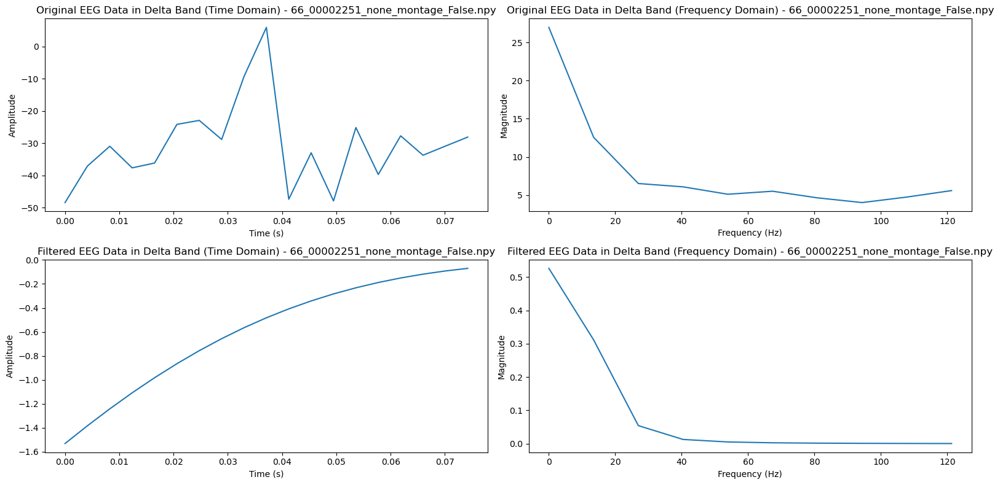

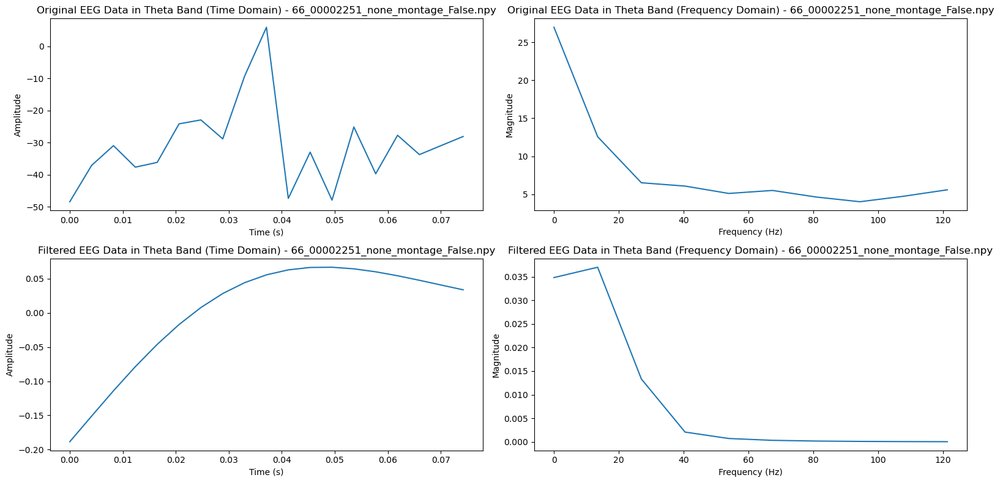

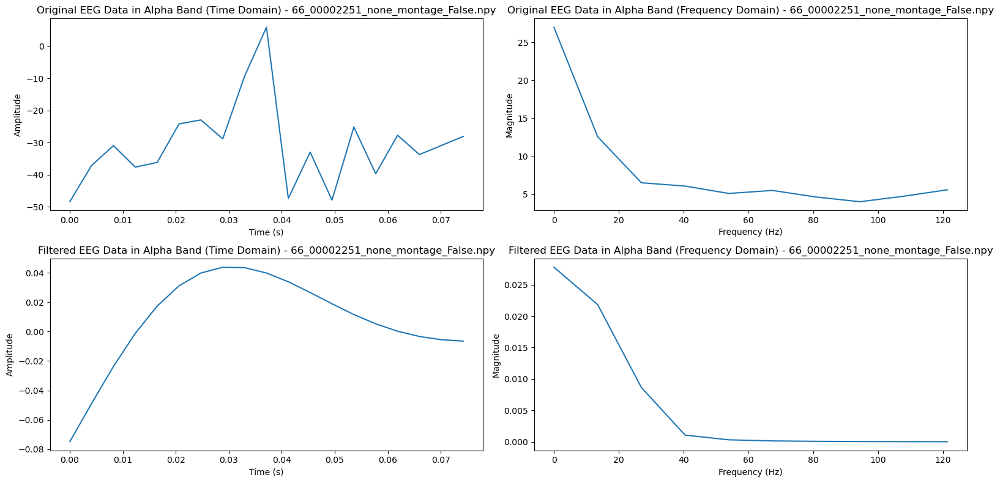

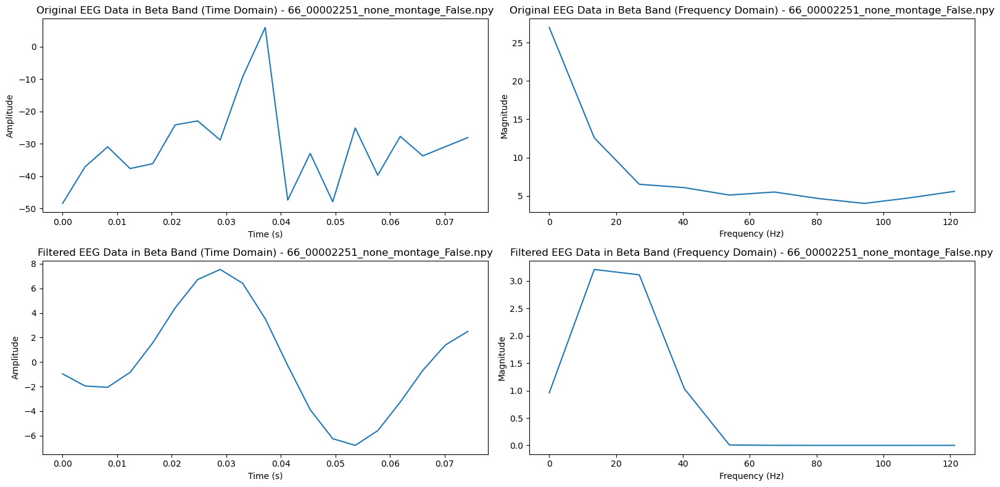

In [39]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz
import os

# Function to create Butterworth filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply filter to data
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    padlen = max(0, len(data) - 1)  # Adjust padding length dynamically
    y = filtfilt(b, a, data, padlen=padlen)
    return y

# Define frequency bands (in Hz)
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 12),
    'Beta': (12, 30)
}

# Specify the directory containing the EEG data files
data_directory = '/home/nalin/Downloads/eeg_data_files-20240411'

# Iterate through the files in the specified directory
for file_name in sorted(os.listdir(data_directory)):
    if file_name.endswith('.npy'):
        file_path = os.path.join(data_directory, file_name)
        eeg_data = np.load(file_path).T  # Transpose to read rows as channels

        # Assuming the data is sampled at a constant frequency
        # You may need additional information about the sampling rate from the data provider
        # For this example, let's assume a sampling rate of 256 Hz
        fs = 256

        # Filter and plot for each frequency band
        for band, (lowcut, highcut) in bands.items():
            # Normalize cutoff frequencies by Nyquist frequency
            lowcut = lowcut
            highcut = highcut

            # Filter EEG data
            filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

            # Plot time and frequency domains for original and filtered signals
            plt.figure(figsize=(16, 8))
            
            # Plot original signal in time domain
            plt.subplot(2, 2, 1)
            plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0])
            plt.title('Original EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')

            # Plot original signal in frequency domain
            plt.subplot(2, 2, 2)
            plt.magnitude_spectrum(eeg_data[0], Fs=fs)
            plt.title('Original EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')

            # Plot filtered signal in time domain
            plt.subplot(2, 2, 3)
            plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data)
            plt.title('Filtered EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')

            # Plot filtered signal in frequency domain
            plt.subplot(2, 2, 4)
            plt.magnitude_spectrum(filtered_data, Fs=fs)
            plt.title('Filtered EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')

            plt.tight_layout()
            plt.show()


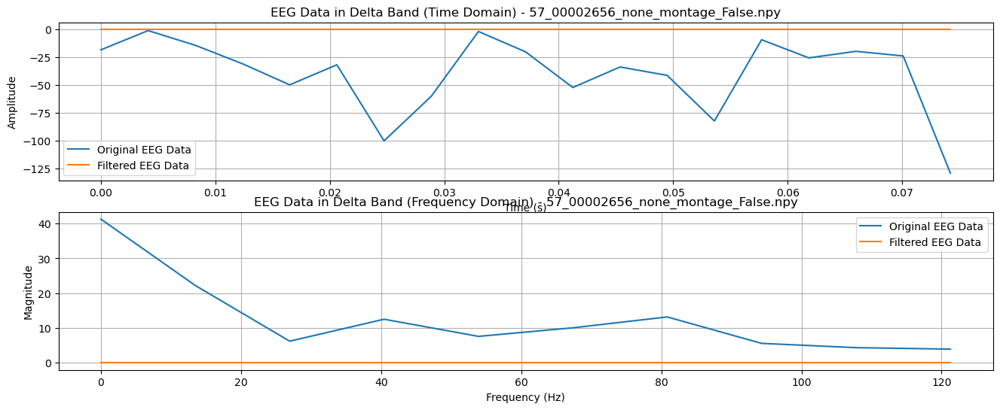

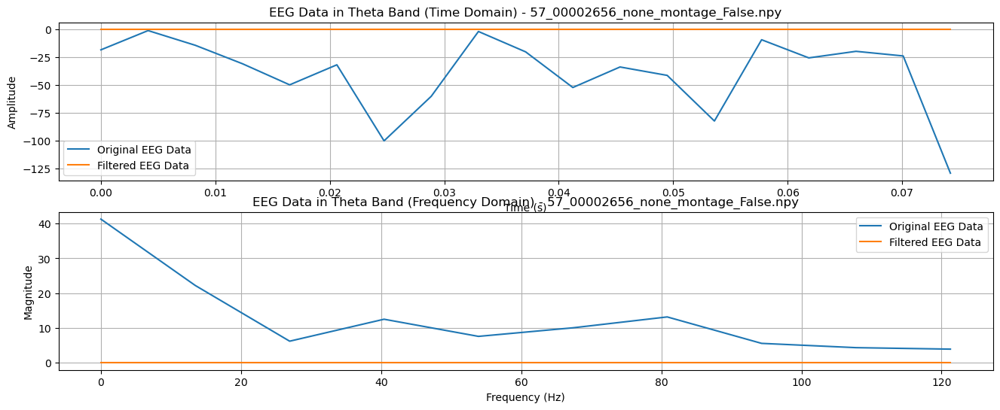

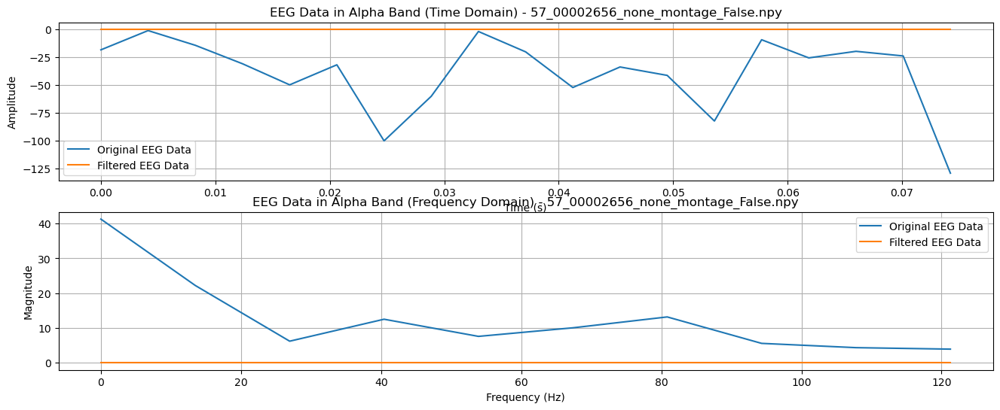

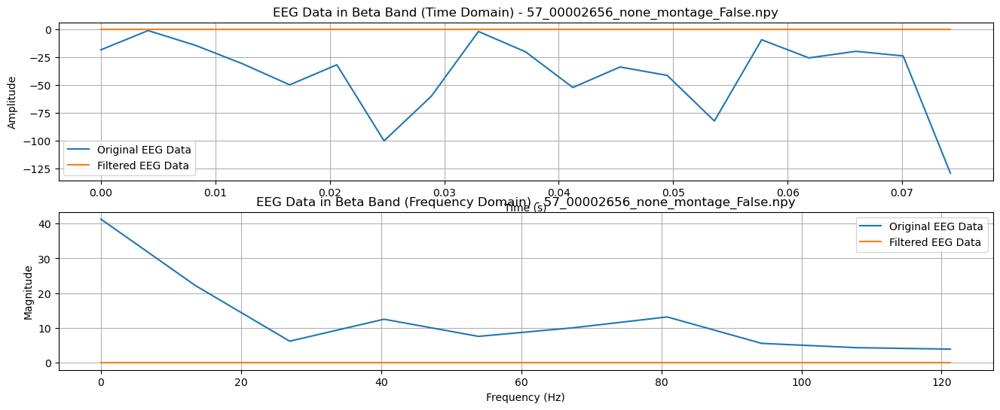

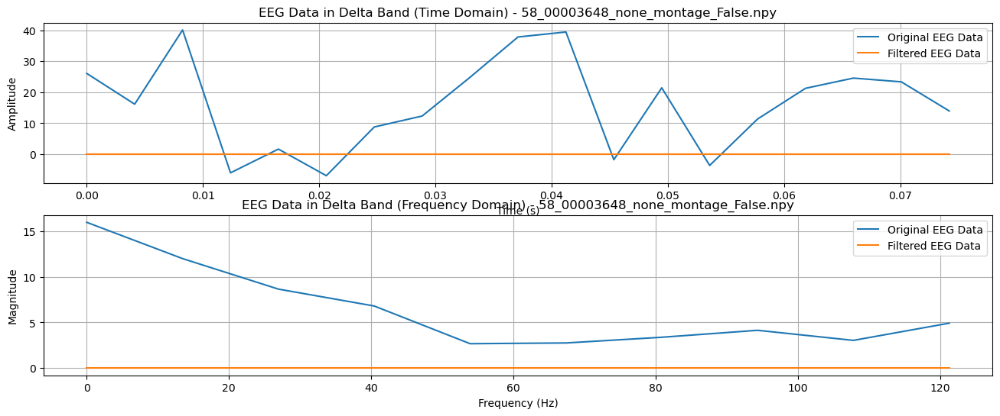

...

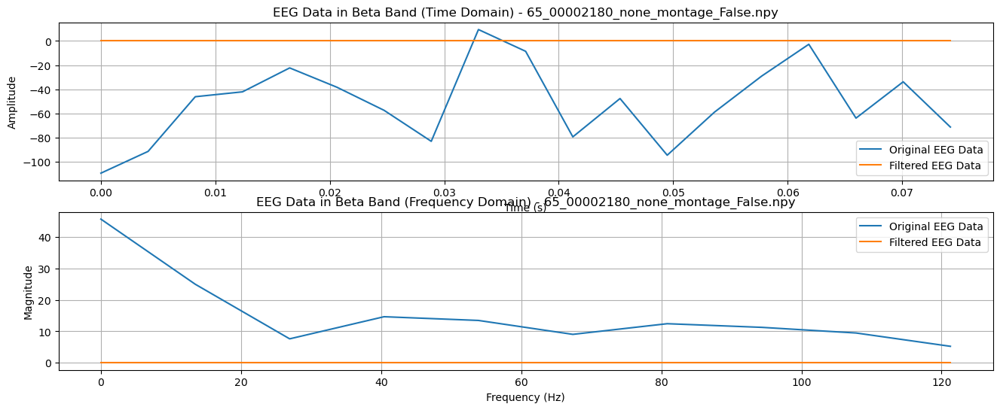

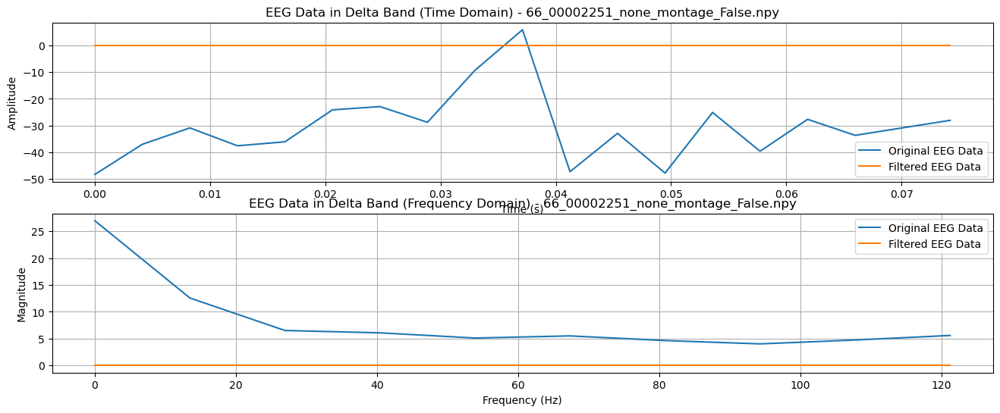

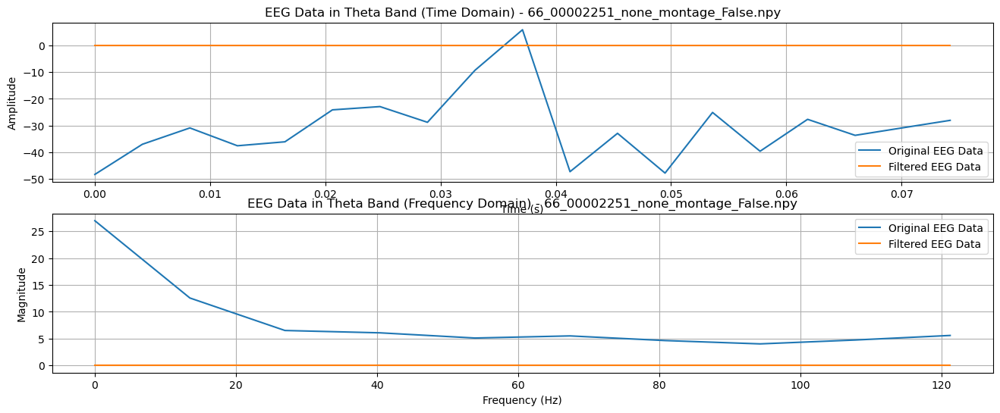

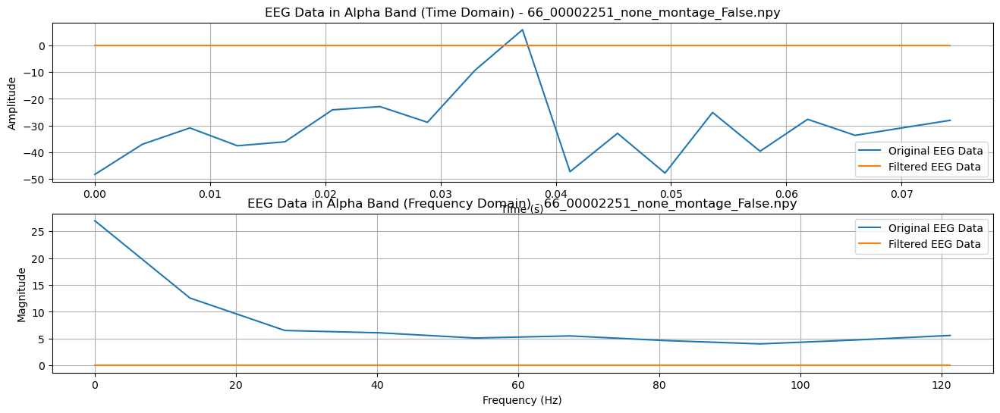

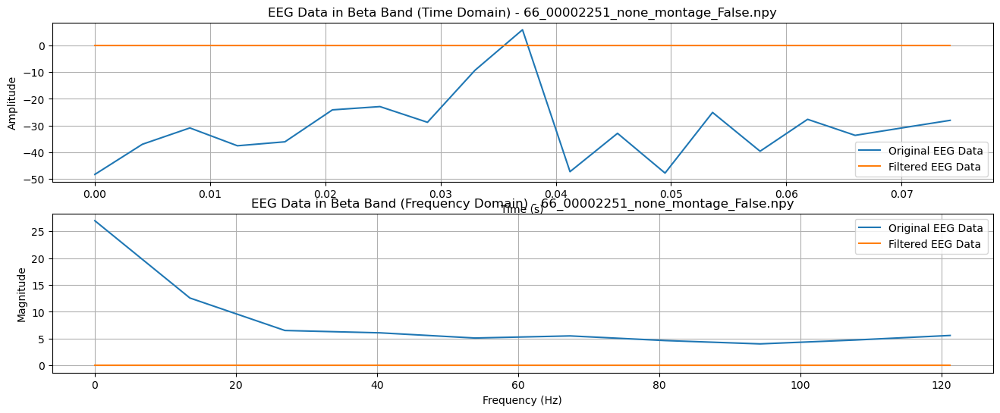

In [40]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, freqz
import os

# Function to create Butterworth filter
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

# Function to apply filter to data
def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    padlen = max(0, len(data) - 1)  # Adjust padding length dynamically
    y = filtfilt(b, a, data, padlen=padlen)
    return y

# Define frequency bands (in Hz)
bands = {
    'Delta': (0.5, 4),
    'Theta': (4, 8),
    'Alpha': (8, 12),
    'Beta': (12, 30)
}

# Specify the directory containing the EEG data files
data_directory = '/home/nalin/Downloads/eeg_data_files-20240411'

# Iterate through the files in the specified directory
for file_name in sorted(os.listdir(data_directory)):
    if file_name.endswith('.npy'):
        file_path = os.path.join(data_directory, file_name)
        eeg_data = np.load(file_path).T  # Transpose to read rows as channels

        # Assuming the data is sampled at a constant frequency
        # You may need additional information about the sampling rate from the data provider
        # For this example, let's assume a sampling rate of 256 Hz
        fs = 256

        # Filter and plot for each frequency band
        for band, (lowcut, highcut) in bands.items():
            # Normalize cutoff frequencies by Nyquist frequency
            lowcut = lowcut / (fs / 2)
            highcut = highcut / (fs / 2)

            # Filter EEG data
            filtered_data = butter_bandpass_filter(eeg_data[0], lowcut, highcut, fs, order=5)

            # Plot time domain
            plt.figure(figsize=(16, 6))
            plt.subplot(2, 1, 1)
            plt.plot(np.linspace(0, len(eeg_data[0])/fs, len(eeg_data[0])), eeg_data[0], label='Original EEG Data')
            plt.plot(np.linspace(0, len(filtered_data)/fs, len(filtered_data)), filtered_data, label='Filtered EEG Data')
            plt.title('EEG Data in ' + band + ' Band (Time Domain) - ' + file_name)
            plt.xlabel('Time (s)')
            plt.ylabel('Amplitude')
            plt.legend()
            plt.grid(True)

            # Plot frequency domain
            plt.subplot(2, 1, 2)
            plt.magnitude_spectrum(eeg_data[0], Fs=fs, label='Original EEG Data')
            plt.magnitude_spectrum(filtered_data, Fs=fs, label='Filtered EEG Data')
            plt.title('EEG Data in ' + band + ' Band (Frequency Domain) - ' + file_name)
            plt.xlabel('Frequency (Hz)')
            plt.ylabel('Magnitude')
            plt.legend()
            plt.grid(True)

        plt.show()


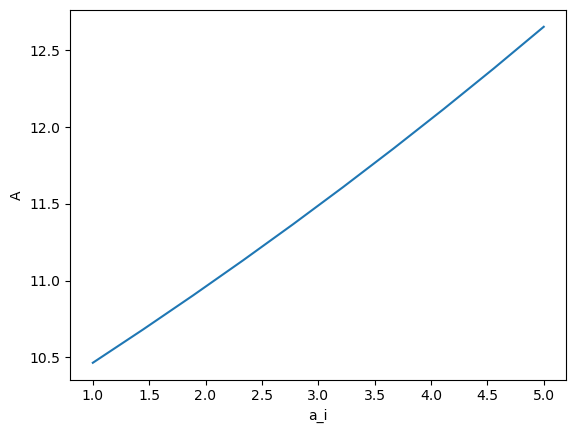

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Define the parameters
N = 10  # Maximum value of i
a = np.linspace(1, 5, N)  # Array of a_i values
n = np.linspace(1, 10, N)  # Array of n_i values
N_t = 100  # Value of N_t

# Calculate the summation
A = np.zeros(N)
for i in range(N):
    A[i] = np.sum(np.exp(a[i] * (n - 1) / N_t))

# Plot the results
plt.plot(a, A)
plt.xlabel('a_i')
plt.ylabel('A')
plt.show()

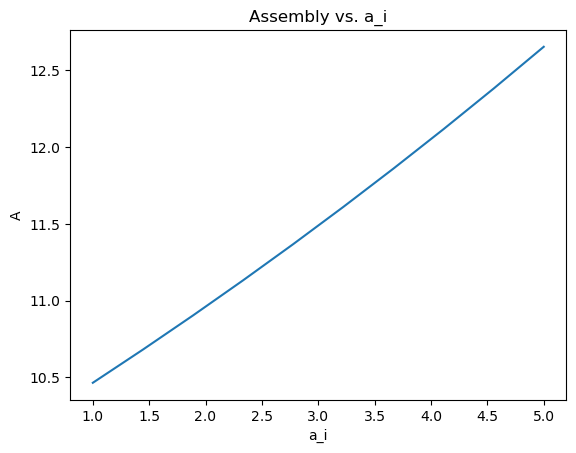

In [2]:
import numpy as np
import matplotlib.pyplot as plt

# Define the parameters
N = 10  # Maximum value of i
a = np.linspace(1, 5, N)  # Array of a_i values
n = np.linspace(1, 10, N)  # Array of n_i values
N_t = 100  # Value of N_t

# Calculate the assembly
A = np.zeros(N)
for i in range(N):
    A[i] = np.sum(np.exp(a[i] * (n - 1) / N_t))

# Plot the results
plt.plot(a, A)
plt.xlabel('a_i')
plt.ylabel('A')
plt.title('Assembly vs. a_i')
plt.show()


In [3]:
class BuildingBlock:
    def __init__(self, name):
        self.name = name

def assemble(current_object, remaining_blocks, assembly_history=[]):
    if is_complete(current_object):  # Check for complete object
        return min(assembly_history), current_object  # Return min steps and object
    for block in remaining_blocks:
        new_object = operation(current_object, block)  # Apply assembly operation
        if is_valid(new_object):
            result = assemble(new_object, remaining_blocks.remove(block), assembly_history+[1])
            if result:  # Update min steps if a valid path is found
                min_steps, assembled_object = result
                return min(min_steps, assembly_history[0]), assembled_object
    return None, None  # No valid path found

# Example usage (replace with your actual functions and building blocks)
block1 = BuildingBlock("Atom 1")
block2 = BuildingBlock("Atom 2")
def operation(obj1, obj2):
    # Combine objects and return a new BuildingBlock representing the assembled structure
    pass

def is_complete(obj):
    # Check if the object is fully assembled based on your criteria
    pass

def is_valid(obj):
    # Check if the assembled object is valid (optional)
    pass

min_steps, assembled_object = assemble(block1, [block2])
if min_steps:
    print(f"Minimum assembly steps: {min_steps}")
    print(f"Assembled object: {assembled_object.name}")  # Access object properties
else:
    print("No valid assembly path found")

# Optional: Simulate copy number
copies = {}
def duplicate(obj):
    # Create a copy of the object and update the copy count in a dictionary
    pass

# ... modify assemble function to call duplicate with a probability


No valid assembly path found


In [4]:
class BuildingBlock:
    def __init__(self, name):
        self.name = name

def assemble(current_object, remaining_blocks, assembly_history=[]):
    if is_complete(current_object):  # Check if the current object is complete
        return min(assembly_history), current_object  # Return min steps and object
    for block in remaining_blocks:
        new_object = operation(current_object, block)  # Apply assembly operation
        if is_valid(new_object):  # Check if the new object is valid
            # Recursively assemble the new object
            result = assemble(new_object, [b for b in remaining_blocks if b != block], assembly_history + [1])
            if result:  # Update min steps if a valid path is found
                min_steps, assembled_object = result
                return min(min_steps, assembly_history[0]), assembled_object
    return None, None  # No valid path found

# Example usage (replace with your actual functions and building blocks)
block1 = BuildingBlock("Atom 1")
block2 = BuildingBlock("Atom 2")

def operation(obj1, obj2):
    # Combine objects and return a new BuildingBlock representing the assembled structure
    pass

def is_complete(obj):
    # Check if the object is fully assembled based on your criteria
    pass

def is_valid(obj):
    # Check if the assembled object is valid (optional)
    pass

# Perform assembly
min_steps, assembled_object = assemble(block1, [block2])
if min_steps:
    print(f"Minimum assembly steps: {min_steps}")
    print(f"Assembled object: {assembled_object.name}")  # Access object properties
else:
    print("No valid assembly path found")

# Optional: Simulate copy number
copies = {}

def duplicate(obj):
    # Create a copy of the object and update the copy count in a dictionary
    pass

# ... modify assemble function to call duplicate with a probability


No valid assembly path found


In [5]:
import random
import string

class BuildingBlock:
    def __init__(self, name):
        self.name = name

def generate_random_name():
    # Generate a random name consisting of 6 characters
    return ''.join(random.choices(string.ascii_uppercase + string.digits, k=6))

def operation(obj1, obj2):
    # Placeholder for the assembly operation
    # You need to implement the actual assembly operation here
    pass

def is_complete(obj):
    # Placeholder for the completeness criteria
    # You need to implement the actual completeness criteria here
    pass

def is_valid(obj):
    # Placeholder for the validation checks
    # You need to implement the actual validation logic here
    pass

def assemble(current_object, remaining_blocks, assembly_history=[]):
    if is_complete(current_object):  # Check if the current object is complete
        return min(assembly_history), current_object  # Return min steps and object
    for block in remaining_blocks:
        new_object = operation(current_object, block)  # Apply assembly operation
        if is_valid(new_object):  # Check if the new object is valid
            # Recursively assemble the new object
            result = assemble(new_object, [b for b in remaining_blocks if b != block], assembly_history + [1])
            if result:  # Update min steps if a valid path is found
                min_steps, assembled_object = result
                return min(min_steps, assembly_history[0]), assembled_object
    return None, None  # No valid path found

# Generate random building blocks
block1 = BuildingBlock(generate_random_name())
block2 = BuildingBlock(generate_random_name())

# Perform assembly
min_steps, assembled_object = assemble(block1, [block2])
if min_steps:
    print(f"Minimum assembly steps: {min_steps}")
    print(f"Assembled object: {assembled_object.name}")  # Access object properties
else:
    print("No valid assembly path found")


No valid assembly path found
